<a href="https://colab.research.google.com/github/tomascammisa/The-Hotel-Bookings-Data/blob/main/take_home_data_scientist.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<hr>
<p style="font-size:40px;text-align:center">Take Home - Data Science</p>
<hr>

# The Hotel Bookings Data
Let’s use hotel bookings data from [Antonio, Almeida, and Nunes (2019)](https://www.sciencedirect.com/science/article/pii/S2352340918315191?via%3Dihub) to predict which hotel stays included children and/or babies, based on the other characteristics of the stays such as which hotel the guests stay at, how much they pay, etc.

<img src="https://s3-us-west-2.amazonaws.com/fligoo.data-science/TechInterviews/HotelBookings/header.png"/>

One of the hotels (H1) is a resort hotel and the other is a city hotel (H2). Both datasets share the same structure, with 23 variables describing the 19248 observations of H1 and 30752 observations of H2. Each observation represents a hotel booking. Both datasets comprehend bookings due to arrive between the 1st of July of 2015 and the 31st of August 2017, including bookings that effectively arrived and bookings that were canceled. Since this is hotel real data, all data elements pertaining hotel or custumer identification were deleted.

**Take-Home Goals**
- During **Part I**, you should perform an Exploratory Data Analysis highlighting key findings:
  - Data Quality Check: You must check the quality of the given dataset to make an assessment of how appropriate it is for later Data Science tasks. Propose a set of corrective actions over the data if any.
  - Report insights and conclusions: Describe the results obtained during the exploratory analysis and provide conclusions from a business perspective, supported by plots / tables / metrics.
- In **Part II** you should define and train a model to predict which actual hotel stays included children/babies, and which did not:
  - Feature extraction: Indicate some possible candidates of features that could properly describe the hotels, either from the given columns or from their transformations.
  - Machine Learning modeling: at least one fitted model with the given data. You could use the `children` column as target.
- Finally, on **Part III** you should present the key findings, conclusions and results to non-technical stakeholders.
  
**Requirements**
- Python 3.x & Pandas 1.x
- Paying attention to the details and narrative is far way more important than extensive development.
- Once you complete the assessment, please send a ZIP file of the folder with all the resources used in this work (e.g. Jupyter notebook, Python scripts, text files, images, etc) or share the repository link.
- Have a final meeting with the team to discuss the work done in this notebook and answer the questions that could arise.
- Finally, but most important: Have fun!

**Nice to have aspects**
- Dockerfile to setup environment / Conda environment for isolation.
- Code versioning with Git (you are free to publish it on your own Github/Bitbucket account!).
- Show proficiency in Python: By showing good practices in the structure and documentation, usage of several programming paradigms (e.g. imperative, OOP, functional), etc.


## Part I - Exploratory Data Analisys

In [485]:
import numpy as np
import pandas as pd

# gráficos
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# preprocesamiento de datos
from sklearn.preprocessing import (
    StandardScaler,
    OneHotEncoder,
    LabelEncoder,
)
import missingno as msno
from sklearn.impute import SimpleImputer

# aprendizaje automático supervisado
from random import sample
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.kernel_ridge import KernelRidge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import (
    cross_val_score,
    cross_val_predict,
    GridSearchCV,
    train_test_split,
)
from scipy.stats import loguniform

from sklearn.metrics import mean_squared_error, r2_score

In [486]:
#Leemos datos y creamos un dataframe llamado hotels

hotels = pd.read_csv('https://s3-us-west-2.amazonaws.com/fligoo.data-science/TechInterviews/HotelBookings/hotels.csv')

In [487]:
hotels.head(5)

,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
0,City_Hotel,217,1,3,2,none,BB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,80.75,none,1,2016-09-01
1,City_Hotel,2,0,1,2,none,BB,PRT,Direct,Direct,...,D,K,0,No_Deposit,0,Transient,170.00,none,3,2017-08-25
2,Resort_Hotel,95,2,5,2,none,BB,GBR,Online_TA,TA/TO,...,A,A,2,No_Deposit,0,Transient,8.00,none,2,2016-11-19
3,Resort_Hotel,143,2,6,2,none,HB,ROU,Online_TA,TA/TO,...,A,A,0,No_Deposit,0,Transient,81.00,none,1,2016-04-26
4,Resort_Hotel,136,1,4,2,none,HB,PRT,Direct,Direct,...,F,F,0,No_Deposit,0,Transient,157.60,none,4,2016-12-28


In [488]:
#Verificamos la "forma" de nuestro dataset, es decir filas por columnas del mismo
hotels.shape

(50000, 23)

Nuestro dataset completo tiene 50.000 filas y 23 columnas

In [489]:
#Verifiquemos ahora el tipo de datos por columna y si todas ellas estan completas o presentan valores nulos
hotels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 23 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hotel                           50000 non-null  object 
 1   lead_time                       50000 non-null  int64  
 2   stays_in_weekend_nights         50000 non-null  int64  
 3   stays_in_week_nights            50000 non-null  int64  
 4   adults                          50000 non-null  int64  
 5   children                        50000 non-null  object 
 6   meal                            50000 non-null  object 
 7   country                         49711 non-null  object 
 8   market_segment                  50000 non-null  object 
 9   distribution_channel            50000 non-null  object 
 10  is_repeated_guest               50000 non-null  int64  
 11  previous_cancellations          50000 non-null  int64  
 12  previous_bookings_not_canceled  

In [490]:
#Contemos los nulos

hotels.isnull().sum()

hotel                               0
lead_time                           0
stays_in_weekend_nights             0
stays_in_week_nights                0
adults                              0
children                            0
meal                                0
country                           289
market_segment                      0
distribution_channel                0
is_repeated_guest                   0
previous_cancellations              0
previous_bookings_not_canceled      0
reserved_room_type                  0
assigned_room_type                  0
booking_changes                     0
deposit_type                        0
days_in_waiting_list                0
customer_type                       0
average_daily_rate                  0
required_car_parking_spaces         0
total_of_special_requests           0
arrival_date                        0
dtype: int64

Tenemos 289 filas nulas en el dataset

In [491]:
#La variable date esta en formato object, procedamos a pasarlo a formato fecha

hotels['arrival_date'] = pd.to_datetime(hotels['arrival_date'])

# Verificar el cambio de tipo de datos
print(hotels.dtypes)

hotel                                     object
lead_time                                  int64
stays_in_weekend_nights                    int64
stays_in_week_nights                       int64
adults                                     int64
children                                  object
meal                                      object
country                                   object
market_segment                            object
distribution_channel                      object
is_repeated_guest                          int64
previous_cancellations                     int64
previous_bookings_not_canceled             int64
reserved_room_type                        object
assigned_room_type                        object
booking_changes                            int64
deposit_type                              object
days_in_waiting_list                       int64
customer_type                             object
average_daily_rate                       float64
required_car_parking

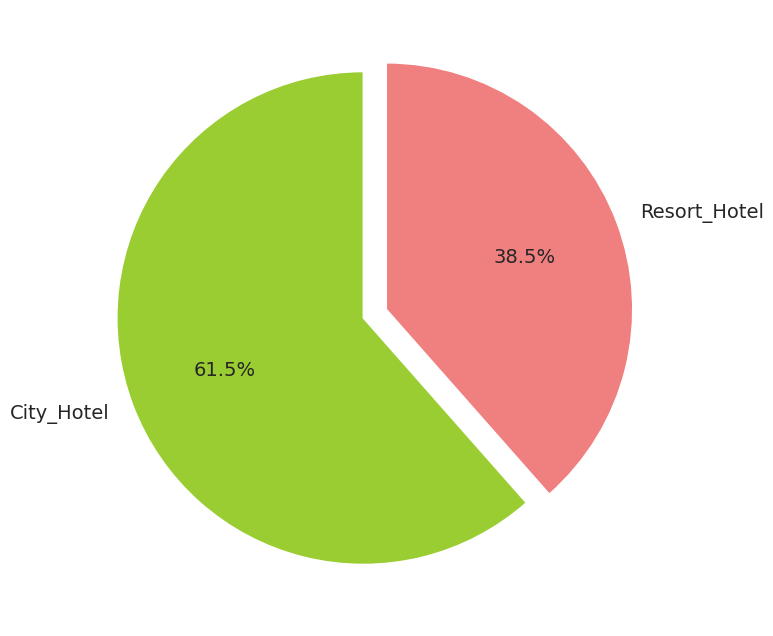

In [492]:
#Verifiquemos la mnuestra de hoteles y cuantos tenemos de cada uno
# Determinamos tamaño del grafico
plt.rcParams['figure.figsize'] = 8,8

# tolist() convertirá el índice en una lista para una fácil manipulación
labels = hotels['hotel'].value_counts().index.tolist()

# Convertir recuentos de valores a una lista
sizes = hotels['hotel'].value_counts().tolist()

explode = (0, 0.1)

# Seteamos colores del grafico
colors = ['yellowgreen', 'lightcoral']

plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%',startangle=90, textprops={'fontsize': 14})
plt.show()

In [493]:
#Descriptivo Variables Numericas
hotels.describe(percentiles=[.1, .2, .3, .4, .5, .6, .7, .8, .9, .99]).T

,count,mean,std,min,10%,20%,30%,40%,50%,60%,70%,80%,90%,99%,max
lead_time,50000.0,80.094120,91.201362,0.00,1.0,5.0,13.00,27.000,45.0,71.0,104.0,150.0,211.00,386.0000,709.0
stays_in_weekend_nights,50000.0,0.928520,0.996288,0.00,0.0,0.0,0.00,0.000,1.0,1.0,2.0,2.0,2.00,4.0000,19.0
stays_in_week_nights,50000.0,2.464540,1.936176,0.00,1.0,1.0,1.00,2.000,2.0,3.0,3.0,4.0,5.00,10.0000,50.0
adults,50000.0,1.830280,0.509078,0.00,1.0,1.0,2.00,2.000,2.0,2.0,2.0,2.0,2.00,3.0000,4.0
is_repeated_guest,50000.0,0.043200,0.203309,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.00,1.0000,1.0
previous_cancellations,50000.0,0.016740,0.287857,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.00,0.0000,13.0
previous_bookings_not_canceled,50000.0,0.202740,1.803691,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.00,5.0000,72.0
booking_changes,50000.0,0.294960,0.740006,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,1.0,1.00,3.0000,21.0
days_in_waiting_list,50000.0,1.570400,14.790300,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.00,58.0000,379.0
average_daily_rate,50000.0,99.942342,49.039092,-6.38,46.0,63.2,73.95,83.632,92.5,104.0,116.5,134.0,162.45,250.7521,510.0


In [494]:
# Otra manera de realizar el mismo análisis es el siguiente
# Seleccionamos todas las columnas numéricas
numeric_cols = hotels.select_dtypes(include=['number']).columns

# Verificamos cuales son las variables numéricas, vemos los valores únicos y calculamos la cantidad
for col in numeric_cols:
    unique_cases = hotels[col].unique()
    print(f"Columna: {col}")
    print("\n", hotels[col].describe())
    print("\nValue Counts\n", hotels[col].value_counts())
    print(f"{'-'*60}")

print('\n\nVariables numéricas:\n', numeric_cols)

Columna: lead_time

 count    50000.000000
mean        80.094120
std         91.201362
min          0.000000
25%          8.000000
50%         45.000000
75%        125.000000
max        709.000000
Name: lead_time, dtype: float64

Value Counts
 0      3915
1      2046
2      1258
3      1142
4      1031
       ... 
382       1
400       1
408       1
709       1
424       1
Name: lead_time, Length: 414, dtype: int64
------------------------------------------------------------
Columna: stays_in_weekend_nights

 count    50000.000000
mean         0.928520
std          0.996288
min          0.000000
25%          0.000000
50%          1.000000
75%          2.000000
max         19.000000
Name: stays_in_weekend_nights, dtype: float64

Value Counts
 0     21640
2     13840
1     13031
4       826
3       564
6        41
5        22
8        18
10        4
12        2
7         2
14        2
9         2
16        2
13        2
19        1
18        1
Name: stays_in_weekend_nights, dtype: int64


In [495]:
obj_cols = []

# Verificamos cuales son las variables object, vemos los valores únicos y calculamos la cantidad
for col in hotels:
    if hotels[col].dtype == 'object':
        unique_cases = hotels[col].unique()
        obj_cols.append(col)
        print("\n", hotels[col].describe())
        print("\nValue Counts\n", hotels[col].value_counts())
        print(f"{'-'*60}")

# En esta lista estan todas las variables categóricas que vamos a transformar
print('\n\nVariables categóricas a transformar:\n', obj_cols)


 count          50000
unique             2
top       City_Hotel
freq           30752
Name: hotel, dtype: object

Value Counts
 City_Hotel      30752
Resort_Hotel    19248
Name: hotel, dtype: int64
------------------------------------------------------------

 count     50000
unique        2
top        none
freq      45962
Name: children, dtype: object

Value Counts
 none        45962
children     4038
Name: children, dtype: int64
------------------------------------------------------------

 count     50000
unique        5
top          BB
freq      38316
Name: meal, dtype: object

Value Counts
 BB           38316
HB            6399
SC            4494
Undefined      580
FB             211
Name: meal, dtype: int64
------------------------------------------------------------

 count     49711
unique      154
top         PRT
freq      14046
Name: country, dtype: object

Value Counts
 PRT    14046
GBR     6405
FRA     5627
ESP     4298
DEU     4047
       ...  
CYM        1
PAN        1
MD

Si se observa la columna "meal", veran que posee 5 categorias ['BB' 'FB' 'HB' 'SC' 'Undefined']. Sin embargo, la categoría 'Undefined' en realidad corresponde a 'SC' (selfcatering, es decir, no incluye comidas), tal como se define en el artículo original. Por lo tanto, reemplazaré su valor por 'SC'.

In [496]:
#Reemplazamos 'undefined' por 'SC'

hotels['meal'].replace(to_replace = 'Undefined', value = 'SC', inplace = True)

In [497]:
#Verificamos

hotels['meal'].unique()

array(['BB', 'HB', 'SC', 'FB'], dtype=object)

In [498]:
#Notamos que country tenia valores nulos, ahora calculemos cuanto es ese porcentaje de valores nulos
print("Porcentaje de valores nulos en country = {0:.3f}%".format(
    100*(hotels.country.isna().sum()/len(hotels))))

Porcentaje de valores nulos en country = 0.578%


In [499]:
#El porcentaje de nulos es infimo, por lo que en este caso optamos por dopear estas filas nulas.
hotels = hotels.dropna(axis = 0)
hotels.isnull().sum()

hotel                             0
lead_time                         0
stays_in_weekend_nights           0
stays_in_week_nights              0
adults                            0
children                          0
meal                              0
country                           0
market_segment                    0
distribution_channel              0
is_repeated_guest                 0
previous_cancellations            0
previous_bookings_not_canceled    0
reserved_room_type                0
assigned_room_type                0
booking_changes                   0
deposit_type                      0
days_in_waiting_list              0
customer_type                     0
average_daily_rate                0
required_car_parking_spaces       0
total_of_special_requests         0
arrival_date                      0
dtype: int64

## Análisis Univariado

In [500]:
# Se define función para la exploración visual
def expl_visual(df_histograma,field):

  f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw= {"height_ratios": (0.2, 1)})
  mean=df_histograma[field].mean()
  median=df_histograma[field].median()
  mode=df_histograma[field].mode().values[0]

  sns.boxplot(data=df_histograma, x=field, ax=ax_box)
  ax_box.axvline(mean, color='r', linestyle='--')
  ax_box.axvline(median, color='g', linestyle='-')
  ax_box.axvline(mode, color='b', linestyle='-')

  sns.histplot(data=df_histograma, x=field, ax=ax_hist, kde=True)
  ax_hist.axvline(mean, color='r', linestyle='--', label="Mean")
  ax_hist.axvline(median, color='g', linestyle='-', label="Median")
  ax_hist.axvline(mode, color='b', linestyle='-', label="Mode")

  ax_hist.legend()

  ax_box.set(xlabel='')
  plt.show()

  print('Media = ',mean)
  print('Mediana = ',median)
  print('Moda principal = ',mode)

In [501]:
# Se define función para detección de Outliers

def outlier(df_in, col_name):

    q1 = df_in[col_name].quantile(0.25)
    q3 = df_in[col_name].quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr

    print("IQR Limite inferior "+str(fence_low))
    print("IQR Limite superior "+str(fence_high))
    print("IQR = ", iqr)

    df_filtered = df_in.loc[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)]
    df_outliers = df_in.loc[(df_in[col_name] < fence_low) | (df_in[col_name] > fence_high)]

    return df_filtered, df_outliers

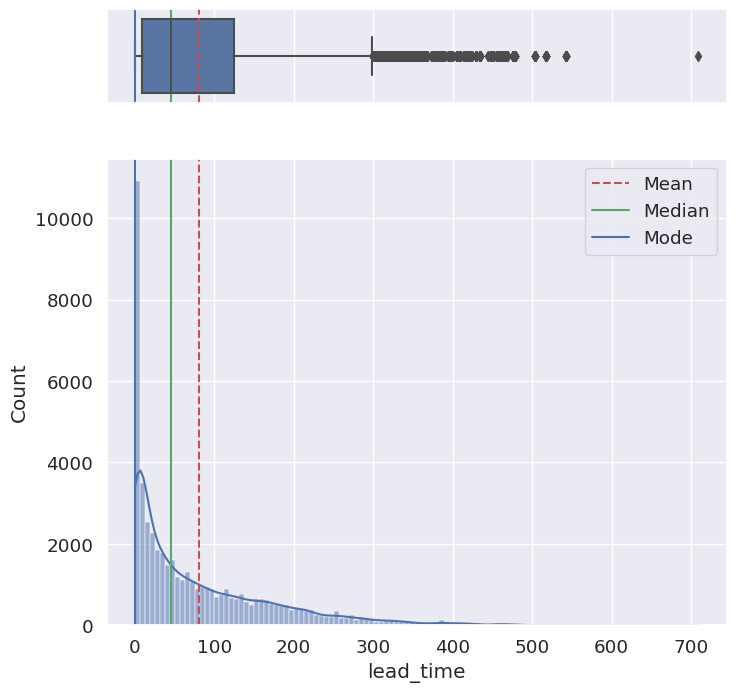

Media =  80.44523344933717
Mediana =  46.0
Moda principal =  0


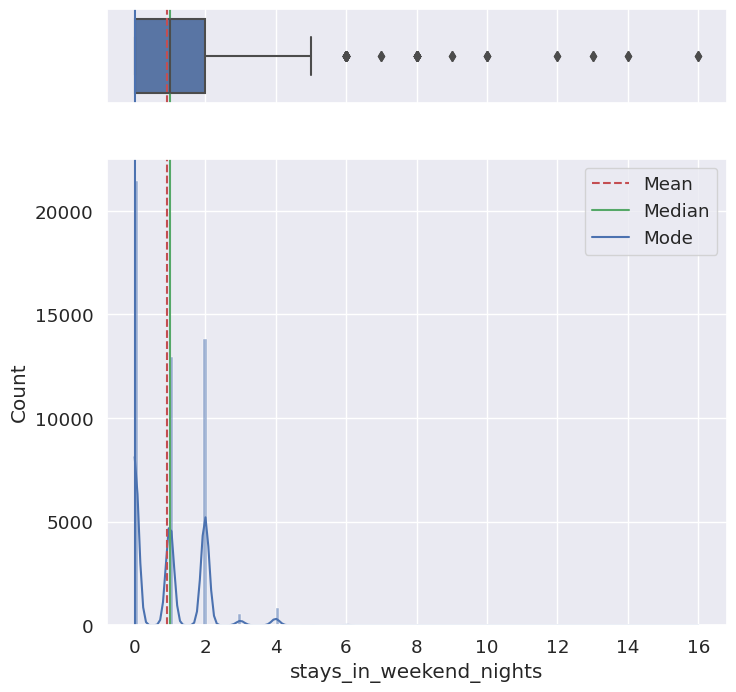

Media =  0.9302367685220575
Mediana =  1.0
Moda principal =  0


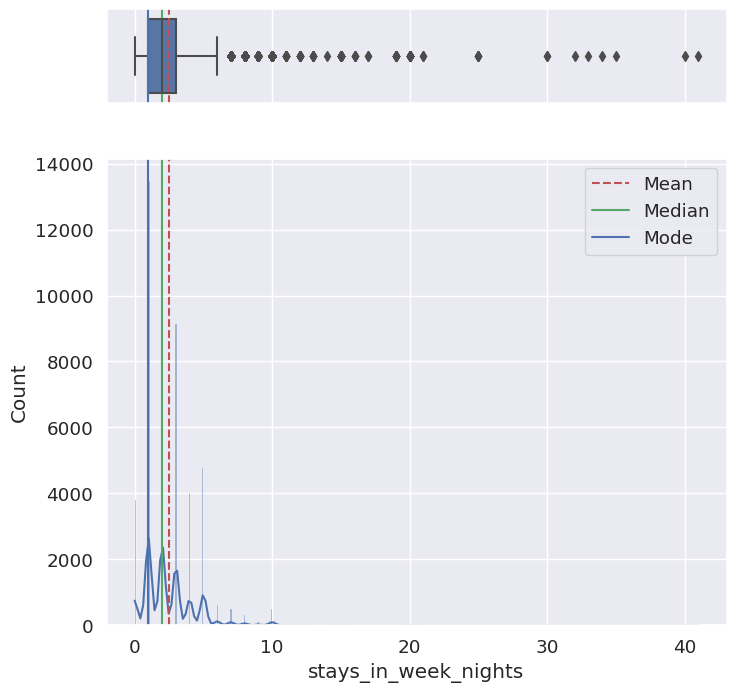

Media =  2.467119953330249
Mediana =  2.0
Moda principal =  1


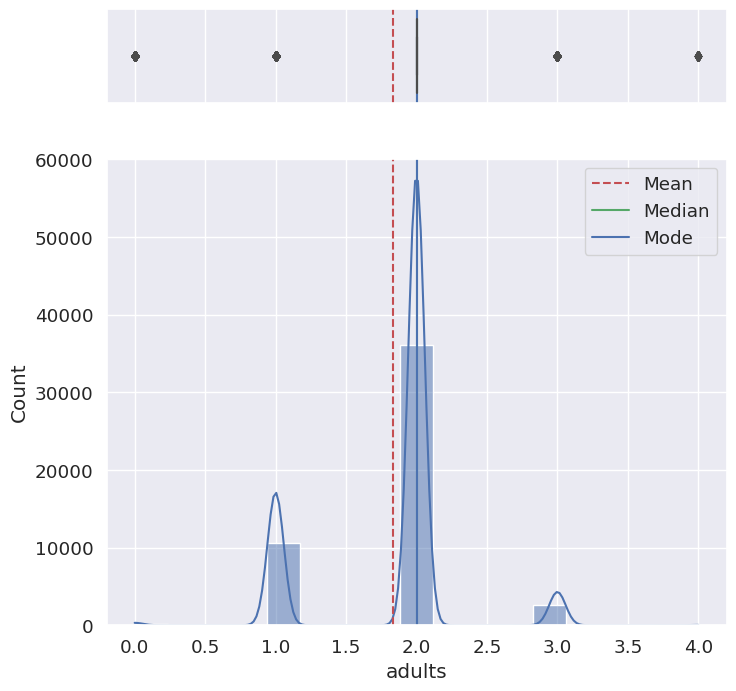

Media =  1.832813662971978
Mediana =  2.0
Moda principal =  2


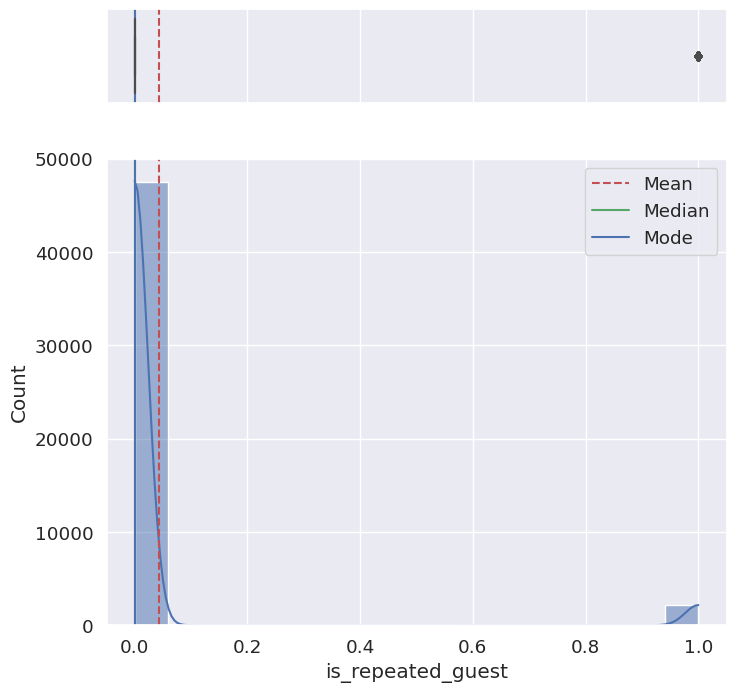

Media =  0.043390798817163206
Mediana =  0.0
Moda principal =  0


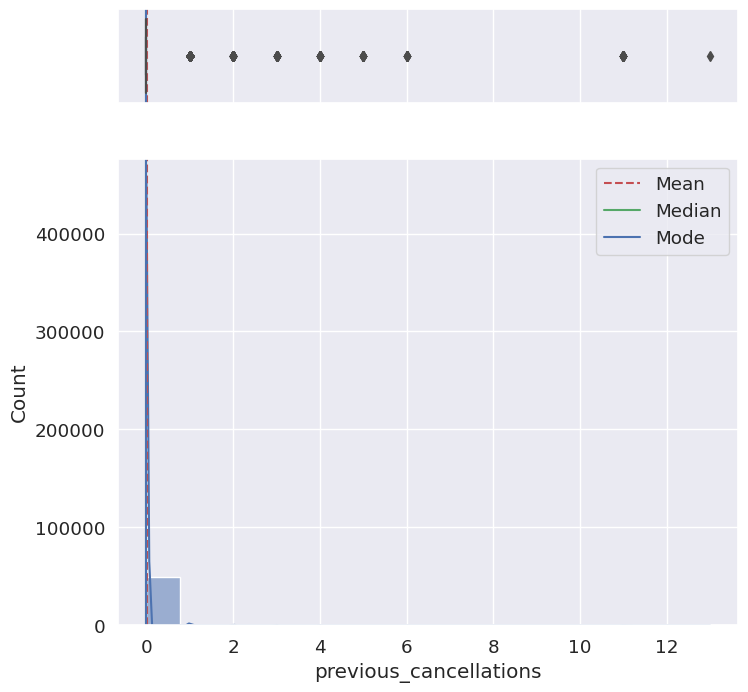

Media =  0.016676389531492024
Mediana =  0.0
Moda principal =  0


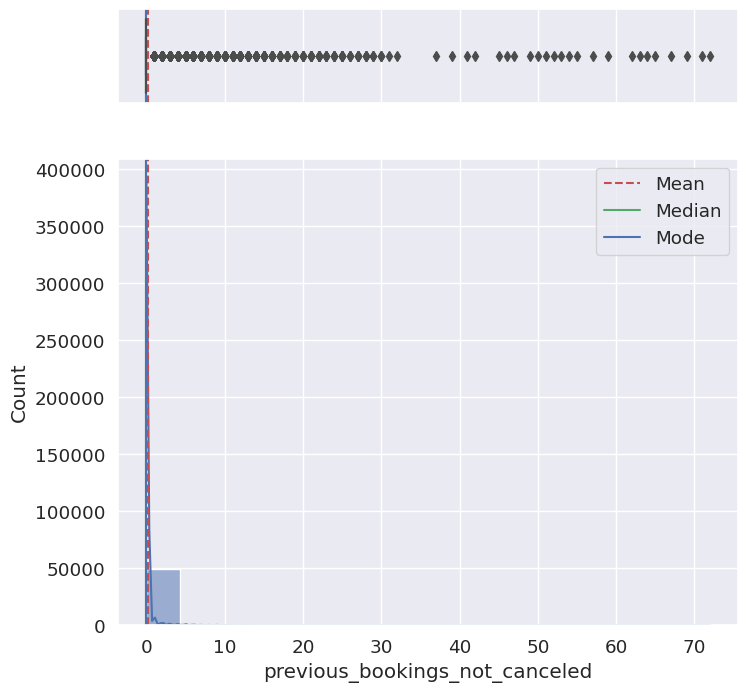

Media =  0.1955703968940476
Mediana =  0.0
Moda principal =  0


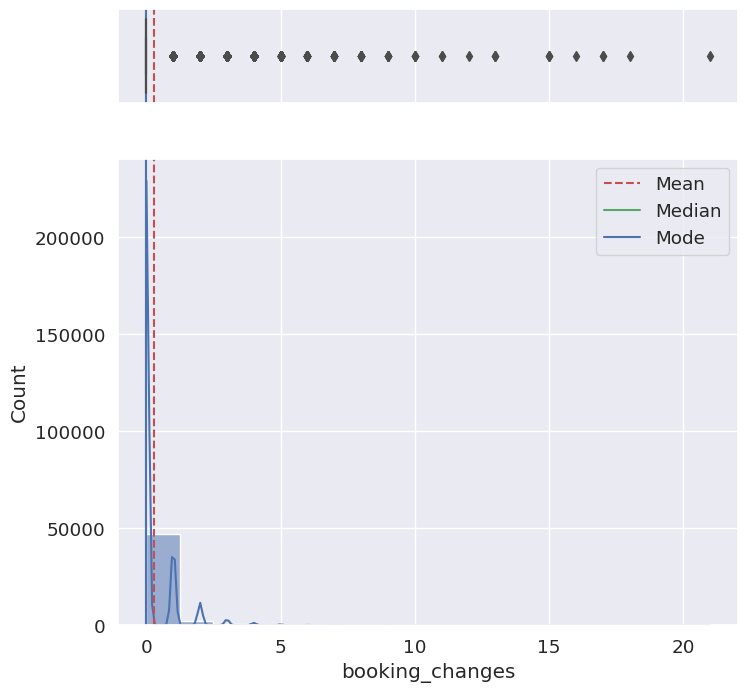

Media =  0.29514594355374063
Mediana =  0.0
Moda principal =  0


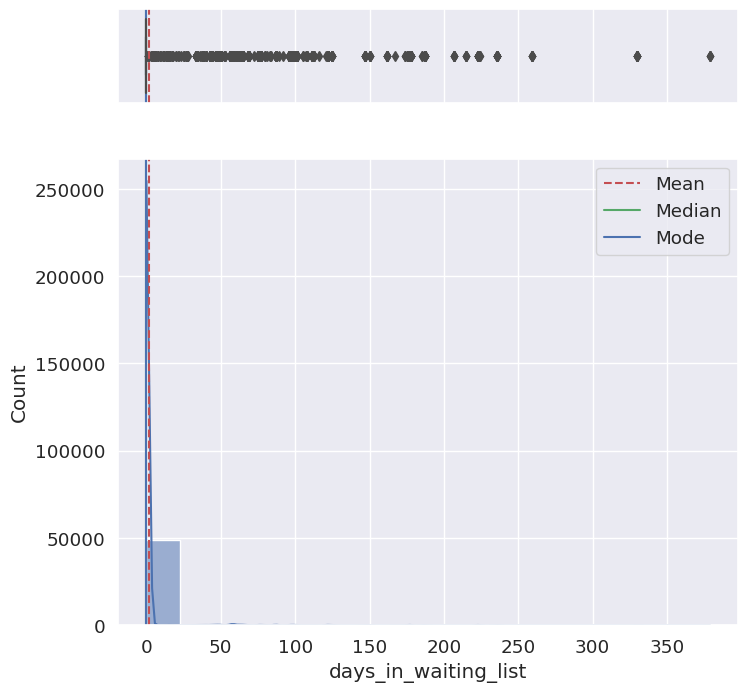

Media =  1.5795296815594133
Mediana =  0.0
Moda principal =  0


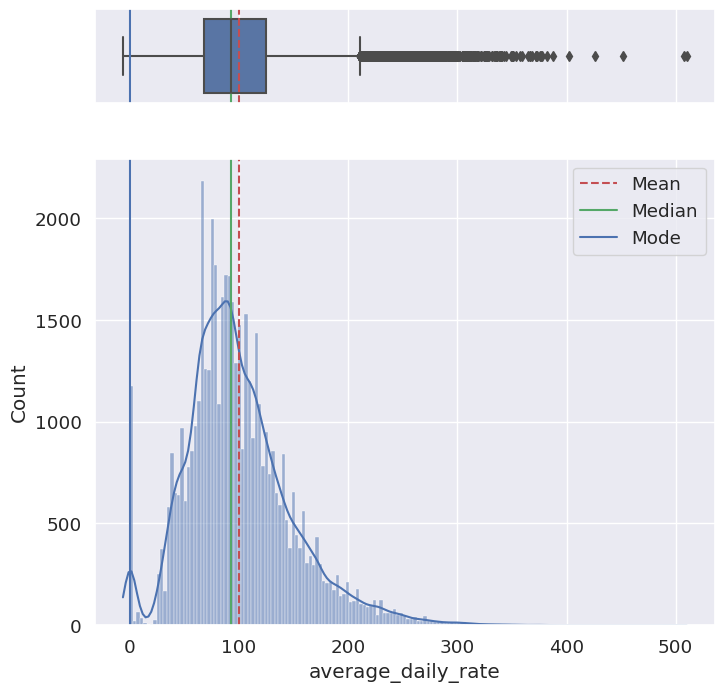

Media =  100.16612057693467
Mediana =  93.0
Moda principal =  0.0


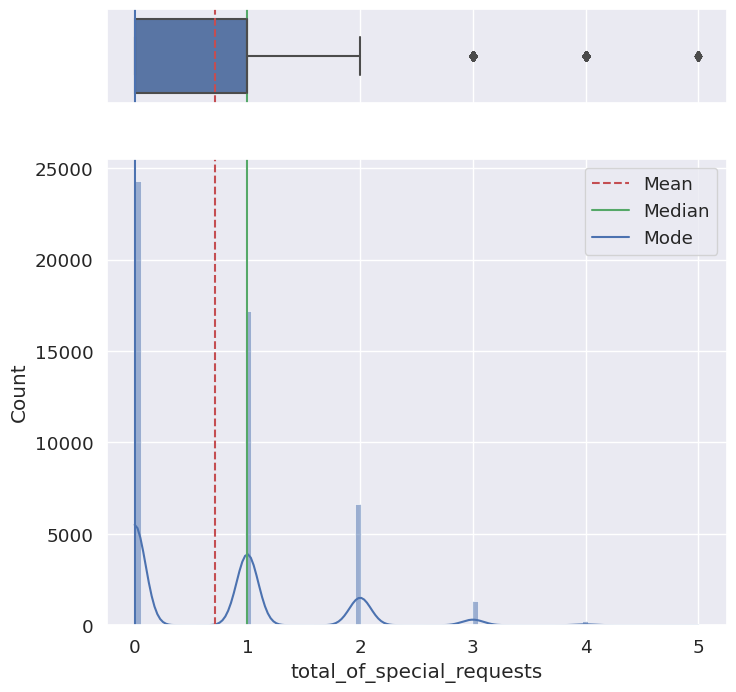

Media =  0.7138460300537105
Mediana =  1.0
Moda principal =  0


In [502]:
# Se aplica la función de exploración para visualizar la distribución de variables cuantitativas
for i in hotels.describe().columns:
    expl_visual(hotels,i)

Se observa que varias de nuestras columnas poseen valores outliers. Mas adelante definiremos si modificamos estos valores o los dejamos como estan.

In [503]:
# Se observan los outliers para lead_time
df_filtered, df_outliers = outlier(hotels,"lead_time")
df_outliers

IQR Limite inferior -165.0
IQR Limite superior 299.0
IQR =  116.0


,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
15,City_Hotel,423,1,1,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,122.40,none,1,2017-07-22
55,City_Hotel,504,2,1,2,none,BB,GBR,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,112.67,none,1,2017-08-12
58,Resort_Hotel,386,1,3,2,none,BB,GBR,Groups,Corporate,...,A,A,2,No_Deposit,0,Transient-Party,49.00,none,0,2016-10-20
103,City_Hotel,457,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,1,No_Deposit,0,Transient-Party,122.40,none,1,2017-08-25
216,City_Hotel,405,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,114.40,none,0,2017-07-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49942,City_Hotel,405,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,114.40,none,0,2017-07-04
49946,City_Hotel,346,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,115.00,none,1,2016-09-13
49955,City_Hotel,338,1,2,2,none,BB,FRA,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,68,Transient-Party,90.67,none,1,2016-10-07
49988,City_Hotel,316,0,3,1,none,BB,AUT,Groups,TA/TO,...,A,A,1,No_Deposit,0,Transient-Party,0.00,none,0,2016-05-26


In [504]:
# Se observan los outliers para previous_bookings_not_cancelled
df_filtered, df_outliers = outlier(hotels,"previous_bookings_not_canceled")
df_outliers

IQR Limite inferior 0.0
IQR Limite superior 0.0
IQR =  0.0


,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
42,Resort_Hotel,4,0,1,1,none,BB,PRT,Offline_TA/TO,TA/TO,...,A,D,0,No_Deposit,0,Transient,30.00,none,2,2016-02-10
104,City_Hotel,3,1,1,1,none,BB,FRA,Direct,Direct,...,A,A,0,No_Deposit,0,Transient,80.00,none,2,2017-02-20
129,Resort_Hotel,2,1,0,2,none,BB,PRT,Online_TA,TA/TO,...,A,D,0,No_Deposit,0,Transient,55.00,none,2,2016-02-14
170,City_Hotel,1,0,3,1,none,BB,PRT,Corporate,Corporate,...,A,A,0,No_Deposit,0,Transient,65.00,none,1,2016-05-03
212,City_Hotel,5,0,1,1,none,BB,PRT,Corporate,Corporate,...,A,A,1,No_Deposit,0,Transient,89.00,none,1,2016-04-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49918,City_Hotel,21,0,1,2,none,BB,PRT,Corporate,Corporate,...,A,A,1,No_Deposit,0,Group,75.00,none,1,2017-08-16
49931,City_Hotel,0,1,1,1,none,BB,PRT,Groups,TA/TO,...,A,A,0,No_Deposit,0,Transient,40.00,none,0,2016-01-25
49959,City_Hotel,4,0,1,1,none,BB,PRT,Corporate,Corporate,...,A,A,0,No_Deposit,0,Transient,66.00,none,0,2016-02-23
49982,Resort_Hotel,2,0,1,1,none,BB,PRT,Corporate,Corporate,...,A,A,0,No_Deposit,0,Transient,35.00,none,0,2017-02-08


In [505]:
# Se observan los outliers para previous_bookings_not_cancelled
df_filtered, df_outliers = outlier(hotels,"average_daily_rate")
df_outliers

IQR Limite inferior -17.5
IQR Limite superior 210.5
IQR =  57.0


,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
6,Resort_Hotel,47,0,2,2,children,BB,ESP,Direct,Direct,...,C,C,0,No_Deposit,0,Transient,289.00,none,1,2017-08-23
40,Resort_Hotel,127,2,5,2,children,HB,PRT,Direct,Direct,...,E,E,4,No_Deposit,0,Transient,334.43,parking,4,2017-08-18
100,Resort_Hotel,81,1,4,2,children,HB,PRT,Direct,Direct,...,A,A,1,No_Deposit,0,Transient,228.75,parking,0,2017-07-05
102,City_Hotel,31,0,1,3,children,BB,ESP,Online_TA,TA/TO,...,F,F,0,No_Deposit,0,Transient,225.40,none,1,2016-08-25
123,City_Hotel,2,0,1,3,none,BB,PRT,Online_TA,TA/TO,...,D,D,0,No_Deposit,0,Transient,230.00,none,1,2017-08-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49862,Resort_Hotel,219,1,4,2,children,SC,PRT,Direct,Direct,...,A,A,3,No_Deposit,0,Transient,249.38,parking,0,2017-07-24
49925,Resort_Hotel,34,2,2,2,none,HB,ESP,Online_TA,TA/TO,...,A,A,0,No_Deposit,0,Transient,221.00,none,2,2015-08-09
49945,Resort_Hotel,55,1,4,3,children,BB,PRT,Online_TA,TA/TO,...,H,H,0,No_Deposit,0,Transient,286.00,parking,0,2016-08-08
49966,Resort_Hotel,47,0,3,2,children,HB,RUS,Online_TA,TA/TO,...,C,C,0,No_Deposit,0,Transient,255.00,none,2,2015-08-13


Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.
Passing `palette` without assigning `hue` is deprecated.


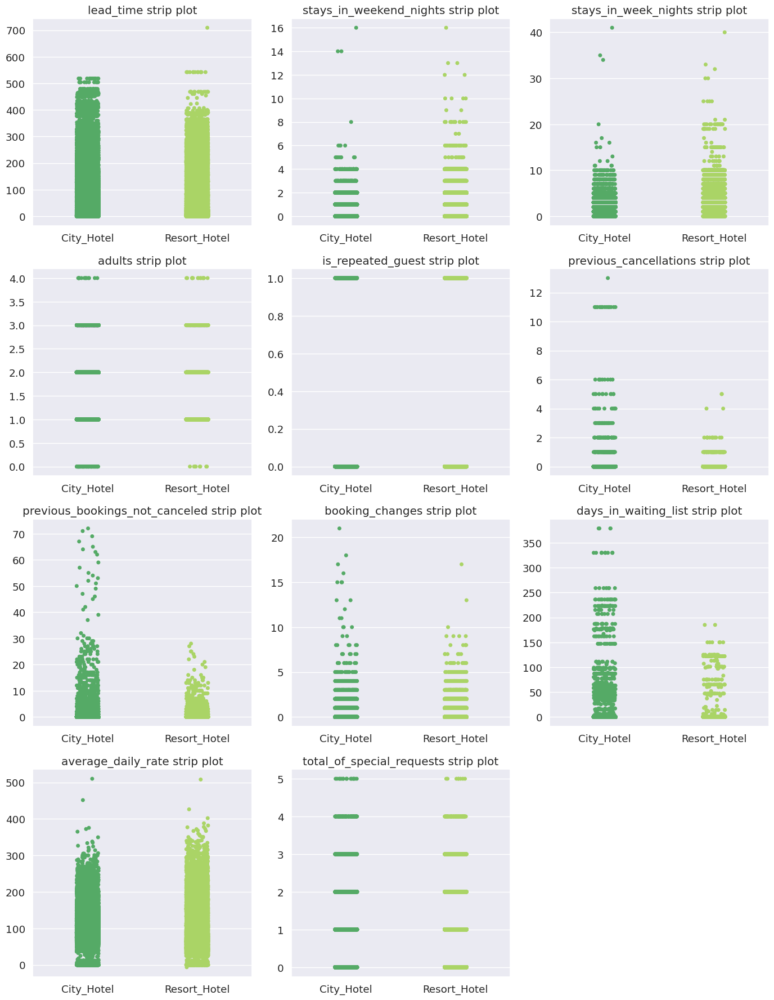

In [506]:
#Creación de un gráfico para visualizar las diferencias en la distribución de datos entre hoteles

features = numeric_cols

n = 1

sns.set_style('darkgrid')
sns.set(font_scale = 1.2)
plt.figure(figsize = (14, 18))

for feature in features:
    plt.subplot(4,3,n)
    sns.stripplot(x = hotels['hotel'], y = hotels[feature], palette = 'summer').set(xlabel = None, ylabel = None)
    plt.title(f'{feature} strip plot')
    n = n + 1
    plt.tight_layout()

Podemos extraer algunas ideas interesantes de esto:

En la columna lead_time los datos empiezan a estar más dispersos a partir del valor 400, aproximadamente.

Las columnas Stays_in_weekend_nights y Stays_in_week_nights muestran valores atípicos más altos para el resort que para el hotel urbano, aunque ambos hoteles comienzan a mostrar datos más dispersos a los 6 y 10 días, para cada columna.

In [507]:
hotels.columns

Index(['hotel', 'lead_time', 'stays_in_weekend_nights', 'stays_in_week_nights',
       'adults', 'children', 'meal', 'country', 'market_segment',
       'distribution_channel', 'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type',
       'days_in_waiting_list', 'customer_type', 'average_daily_rate',
       'required_car_parking_spaces', 'total_of_special_requests',
       'arrival_date'],
      dtype='object')

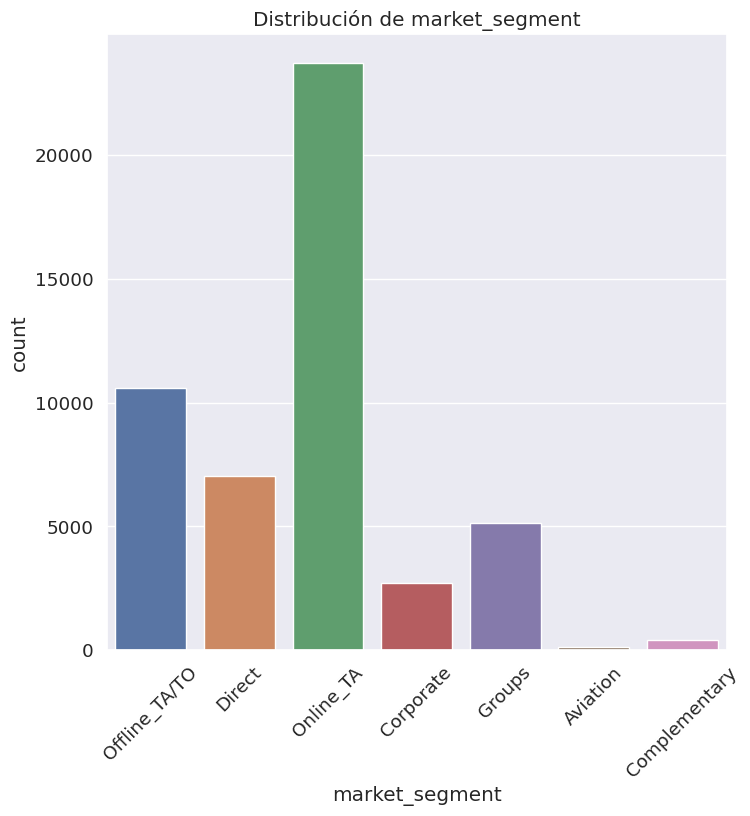

In [508]:
#Definimos funcion countplot
def plot_count_distribution(data, column, title):
    ax = sns.countplot(x=data[column])
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    ax.set_title(title)
    plt.show()

# Verificamos la distribución del segmento asignado a la reserva
plot_count_distribution(hotels, 'market_segment', 'Distribución de market_segment')


El segmento Online_TA (Online Travel Agents) es el mayoritario, seguido de Offline_TA/TO

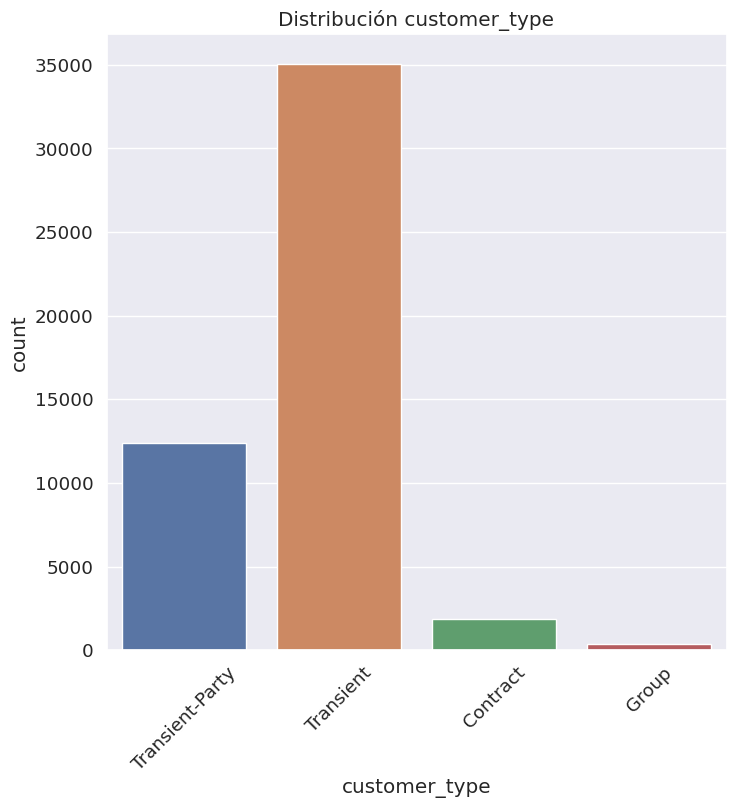

In [509]:
# Verificamos la distribución de customer_type
plot_count_distribution(hotels, 'customer_type', 'Distribución customer_type')

Casi toda la muestra corresponde a Transiet

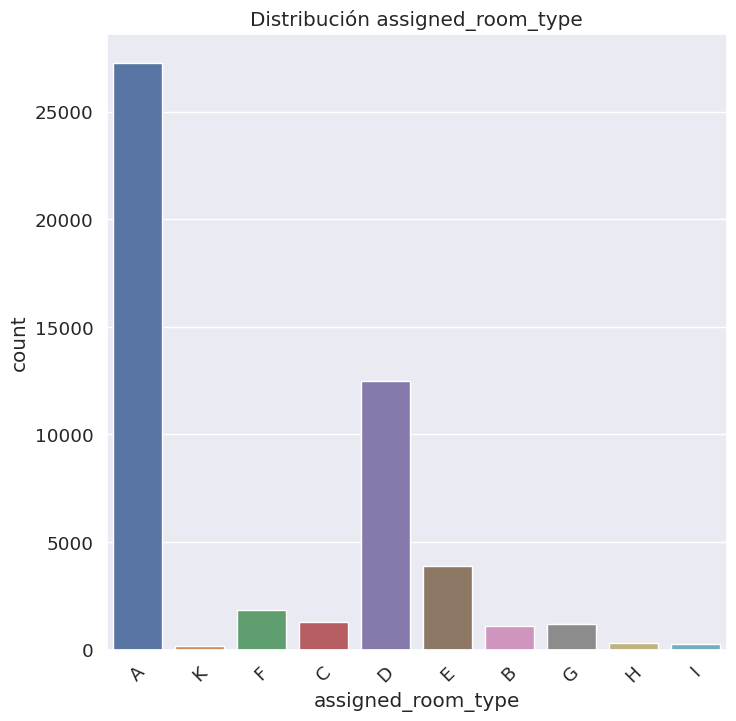

In [510]:
# Verificamos la distribución de assigned_room_type
plot_count_distribution(hotels, 'assigned_room_type', 'Distribución assigned_room_type')

Mas de la mitad de las reservas se asignaron al tipo de habitacion "A"

## Análisis Bivariado

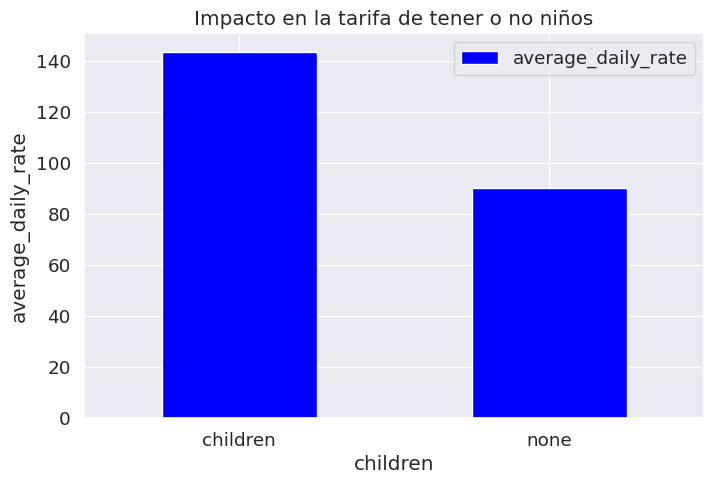

In [511]:
def plot_pivot_median(df, index_col, values_col, title):
    pivot_table = df.pivot_table(index=index_col, values=values_col, aggfunc='median')
    pivot_table.plot(kind='bar', color='blue', figsize=(8, 5))
    plt.xlabel(index_col)
    plt.ylabel(values_col)
    plt.title(title)
    plt.xticks(rotation=0)
    plt.show()

# Impacto en la tarifa de tener o no niños
plot_pivot_median(hotels, 'children', 'average_daily_rate', 'Impacto en la tarifa de tener o no niños')


Logicamente el promedio de tarifa tienendo niños es mas alto

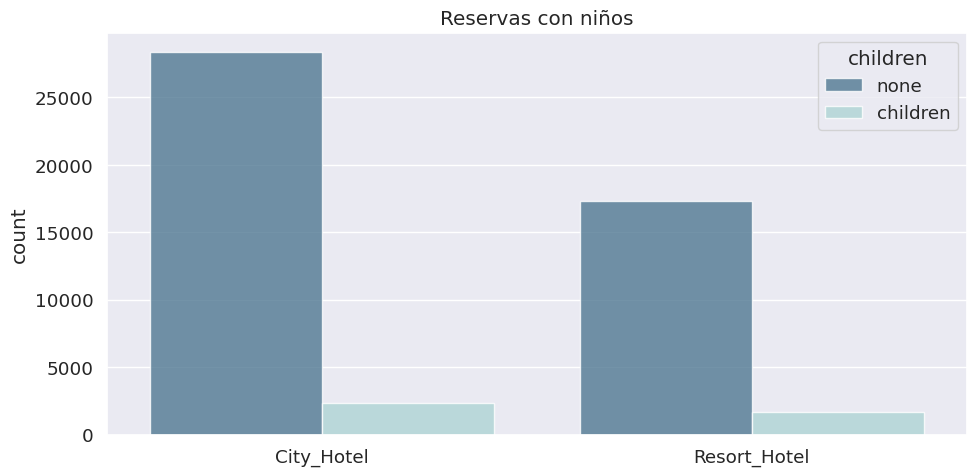

In [512]:
plt.figure(figsize = (10, 5))

palette = ["#457b9d", "#a8dadc"]

sns.countplot(data = hotels, x = 'hotel', hue = 'children', palette = palette, alpha = 0.8).set(xlabel = None)
plt.title('Reservas con niños')

plt.tight_layout()

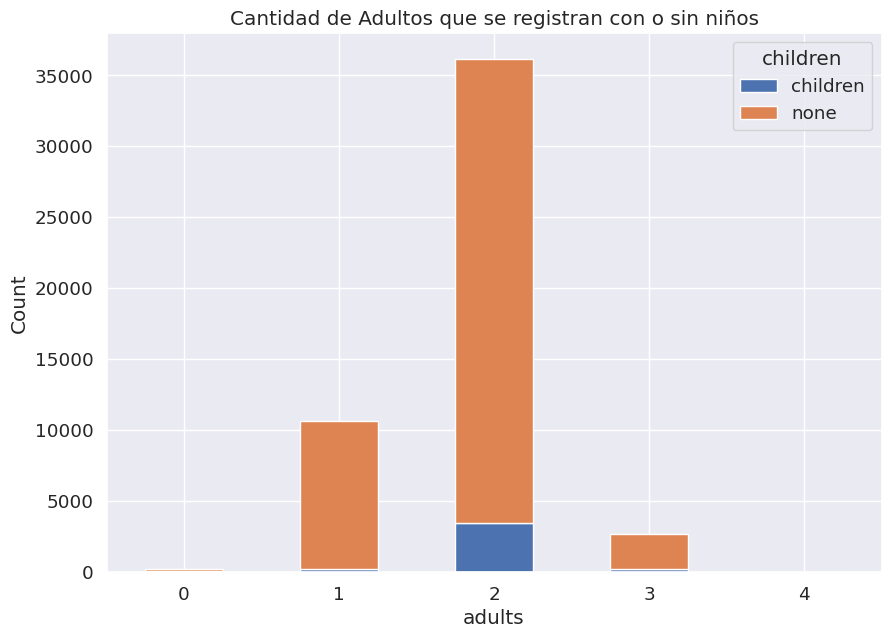

In [513]:
def plot_count_by_category(df, x_col, y_col, title):
    count_table = df.groupby([x_col, y_col]).size().unstack().fillna(0)
    count_table.plot(kind='bar', stacked=True, figsize=(10, 7))
    plt.xlabel(x_col)
    plt.ylabel('Count')
    plt.title(title)
    plt.xticks(rotation=0)
    plt.show()

# Cantidad de Adultos que se registran con o sin niños
plot_count_by_category(hotels, 'adults', 'children', 'Cantidad de Adultos que se registran con o sin niños')


Esto grafico nos indicaría en principio dos cosas. La mayor parte de los niños asisten con dos adultos, y que en la mayoría de los casos no se registran niños. Ahora, veamos dentro de cada registro de adultos, cuantos niños hay registrados.

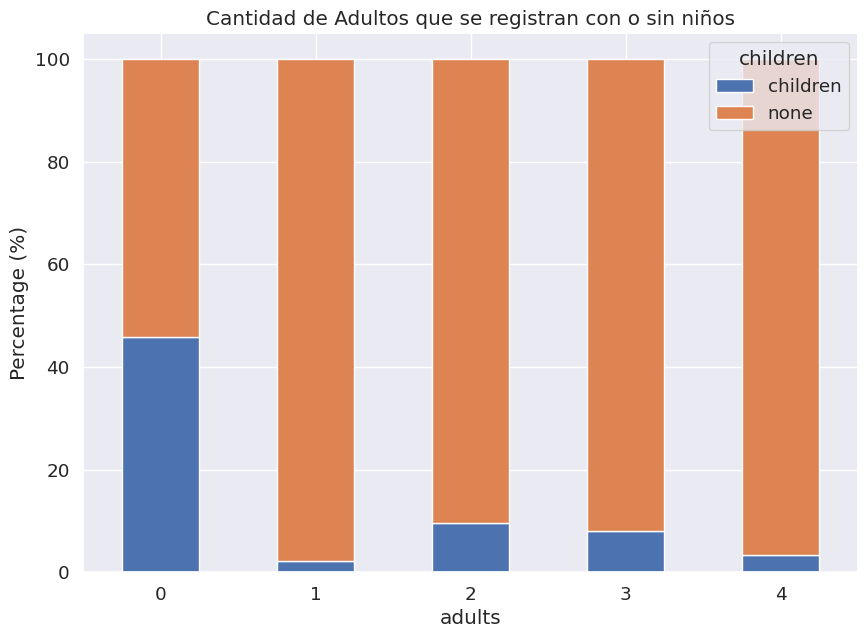

In [514]:
import matplotlib.pyplot as plt

def plot_percentage_by_category(df, x_col, y_col, title):
    count_table = df.groupby([x_col, y_col]).size().unstack().fillna(0)
    percentage_table = count_table.div(count_table.sum(axis=1), axis=0) * 100
    percentage_table.plot(kind='bar', stacked=True, figsize=(10, 7))
    plt.xlabel(x_col)
    plt.ylabel('Percentage (%)')
    plt.title(title)
    plt.xticks(rotation=0)
    plt.show()

# Cantidad de Adultos que se registran con o sin niños
plot_percentage_by_category(hotels, 'adults', 'children', 'Cantidad de Adultos que se registran con o sin niños')


Okey, interesante lo que se muestra. Casi la mitad de las veces en que el registro de adultos es 0, hay registrado al menos un niño. ¿Será porque se les asigna habitaciones individuales?

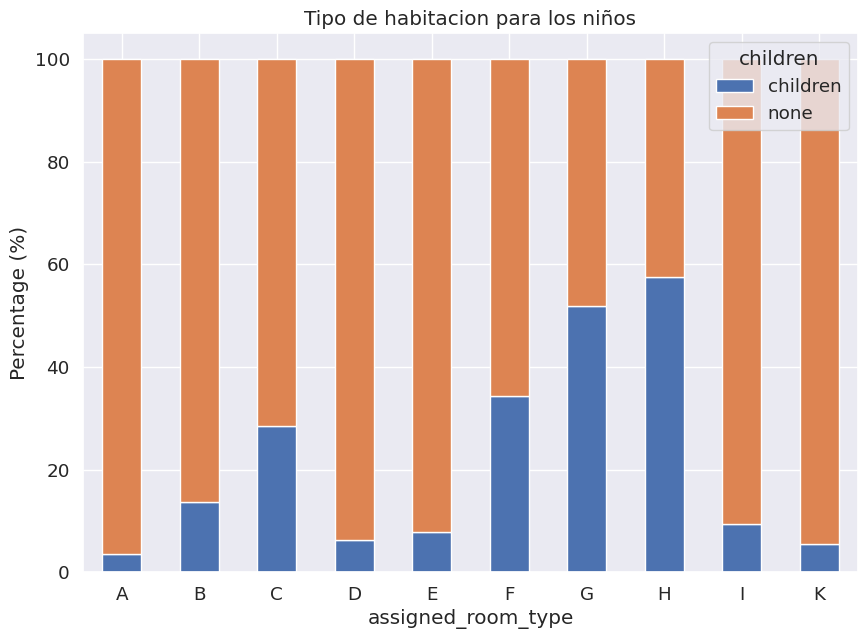

In [515]:
#Veamos el tipo de habitacion tienen asignadas los niños
plot_percentage_by_category(hotels, 'assigned_room_type', 'children', 'Tipo de habitacion para los niños')

Las habitaciones F-G-H son las que mayormente ocupan niños. ¿Acaso estas mismas son las ocupadas por adultos?

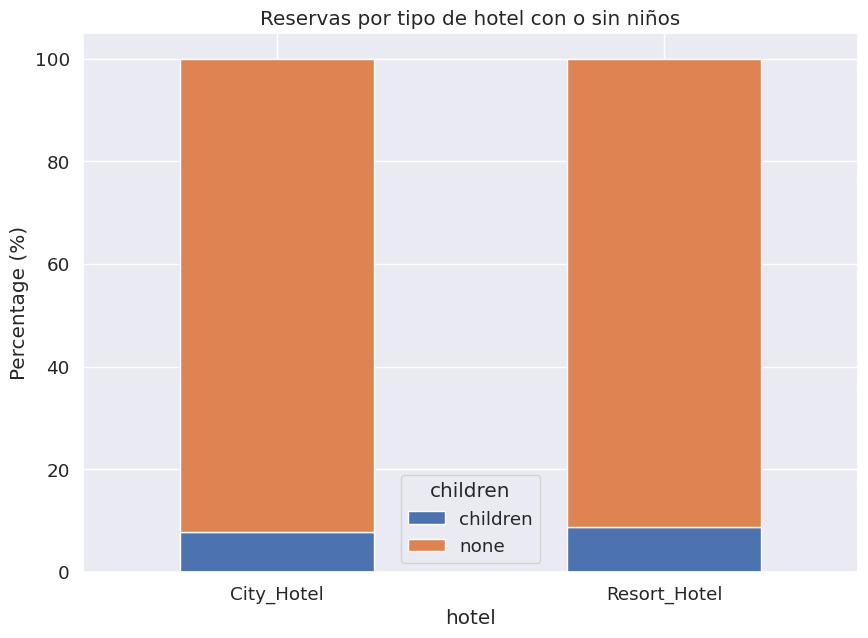

In [516]:
#Veamos el tipo de habitacion tienen asignadas los niños
plot_percentage_by_category(hotels, 'hotel', 'children', 'Reservas por tipo de hotel con o sin niños')

La distribución de reservas con o sin niños por tipo de hotel son casi iguales para ambos tipos de hotel.

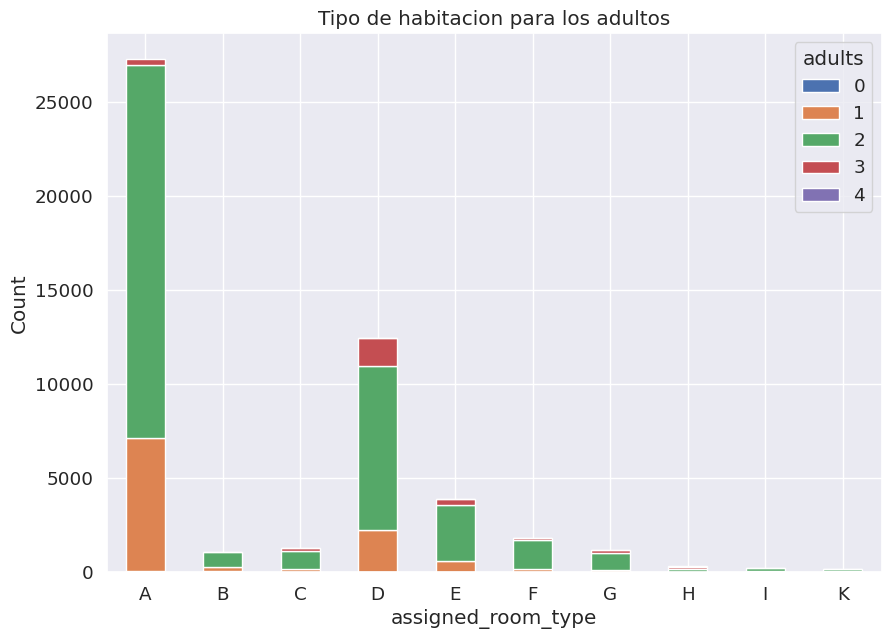

In [517]:
#Veamos el tipo de habitacion tienen asignadas los adultos
plot_count_by_category(hotels, 'assigned_room_type', 'adults', 'Tipo de habitacion para los adultos')

La mayoria de los adultos van a la habitacion A, habitacion individual o para dos personas (agentes de viaje suelen viajar solos). Probablemente es la misma habiotacion que reservan las parejas, reservando las habitaciones F-G-H para sus hijos.

In [518]:
hotels.columns

Index(['hotel', 'lead_time', 'stays_in_weekend_nights', 'stays_in_week_nights',
       'adults', 'children', 'meal', 'country', 'market_segment',
       'distribution_channel', 'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type',
       'days_in_waiting_list', 'customer_type', 'average_daily_rate',
       'required_car_parking_spaces', 'total_of_special_requests',
       'arrival_date'],
      dtype='object')

In [519]:
color = ["#404040", "#CD6889"]

def generate_histogram_chart(data, ver, color_bar, color, title, num):
    fig = px.histogram(
      data,
      x=ver,
      color=color_bar,
      color_discrete_sequence=color,
      marginal="box",
      barmode="group",
      hover_data=data.columns,
      height=540,
      width=840,
      title=title,
    )
    fig.update_traces(opacity= num)
    fig.show()


generate_histogram_chart(hotels, 'arrival_date', 'children', color , 'Epoca de reservas con niños', 0.8)

No llegamos a apreciar algun tipo de estacionalidad de las reservas con niños, probemos filtrando solo las reservas con niños

In [520]:
children = hotels[hotels['children'] == "children"]
generate_histogram_chart(children, 'arrival_date', 'children', color , 'Epoca de reservas con niños', 0.8)

In [521]:
#Veamos solo los adultos solos a ver si tiene la misma estacionalidad en las reservas
adults = hotels[hotels['children'] == "none"]
generate_histogram_chart(adults, 'arrival_date', 'children', color , 'Epoca de reservas solo adultos', 0.8)

Parecieran tener un comportamiento distinto. Mientras que los picos de reservas con niños se presentan entre Julio y Agosto (logico ya que son los meses de verano en el hemisferio norte), los adultos solos tienen una estacionalidad diferente. Estos registran picos de reserva en Septiembre y Octubre, previo a las fiestas, que es cuando las reservas se derrumban.

# Análisis Chi Cuadrado variables categoricas

In [522]:
# Creamos una lista para guardar las features que deberíamos descartar
features_to_discard = []

# Recorremos la lista de variables categóricas y calculamos el chi cuadrado con "children" como target
def calculate_chi_square(df, target_field, obj_cols):
    from scipy import stats

    for field in obj_cols:
        dep1 = pd.crosstab(df[field], df[target_field])
        chi2, p, dof, expected = stats.chi2_contingency(dep1)
        print(f'{field} vs {target_field}')
        print('Chi-squared Test Statistic:', chi2)
        print('P-value:', p)
        print('Degrees of Freedom:', dof)
        print()
        if p > 0.05:
            features_to_discard.append(field)

# Especifica "children" como la variable objetivo
target_variable = "children"

# Calcula el chi cuadrado para cada variable categórica con "children" como target
calculate_chi_square(hotels, target_variable, obj_cols)

# Veamos las variables que deberían descartarse
print('Características que podrían descartarse:', features_to_discard)

hotel vs children
Chi-squared Test Statistic: 16.78514313194593
P-value: 4.18597548206715e-05
Degrees of Freedom: 1

children vs children
Chi-squared Test Statistic: 49697.565291314466
P-value: 0.0
Degrees of Freedom: 1

meal vs children
Chi-squared Test Statistic: 254.65231859073413
P-value: 6.4500191214585124e-55
Degrees of Freedom: 3

country vs children
Chi-squared Test Statistic: 508.0552427906635
P-value: 1.157647995326883e-39
Degrees of Freedom: 153

market_segment vs children
Chi-squared Test Statistic: 1358.9297755459068
P-value: 1.8911717690339674e-290
Degrees of Freedom: 6

distribution_channel vs children
Chi-squared Test Statistic: 493.7412651916039
P-value: 1.5124171550106409e-105
Degrees of Freedom: 4

reserved_room_type vs children
Chi-squared Test Statistic: 10797.37490143005
P-value: 0.0
Degrees of Freedom: 8

assigned_room_type vs children
Chi-squared Test Statistic: 7320.282198800118
P-value: 0.0
Degrees of Freedom: 9

deposit_type vs children
Chi-squared Test Stati

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


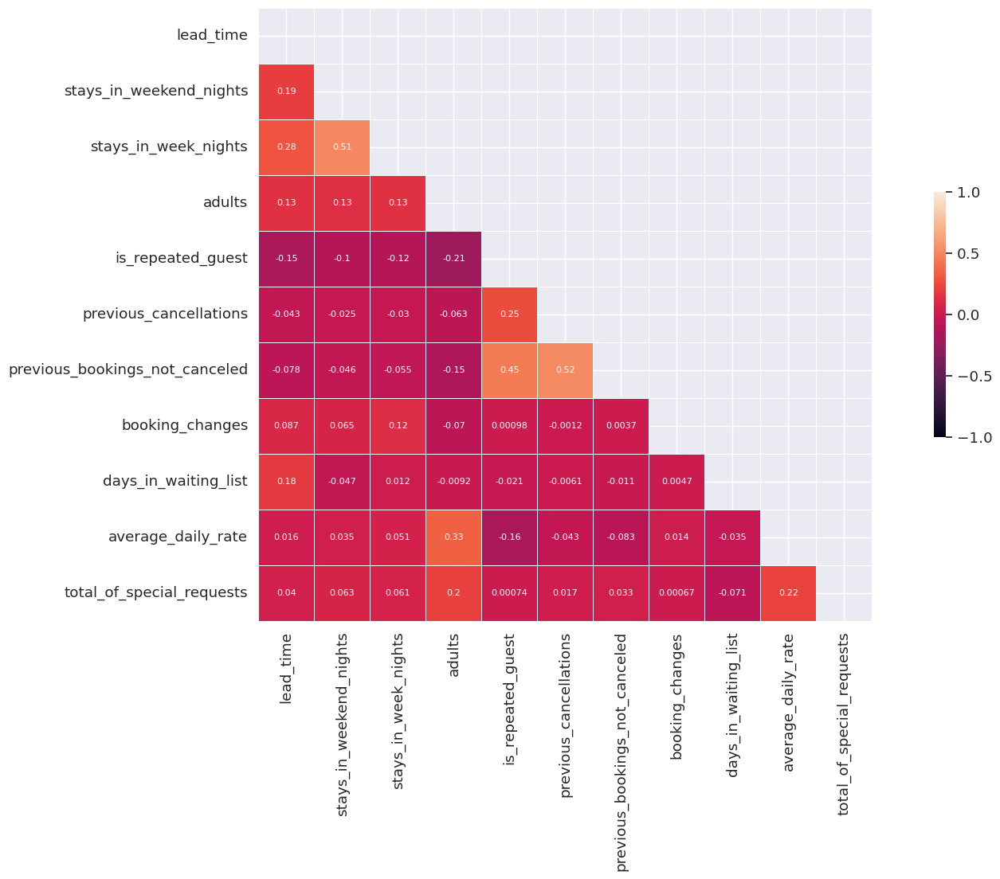

In [523]:
#Veamos la correlacion que existe entre las variables numericas
# Correlacion entre variables numericas

matriz_correlacion = hotels.corr()

# Graficamos la correlacion entre las variables

mask = np.zeros_like(matriz_correlacion, dtype=np.bool)
mask[np.triu_indices_from(mask)]= True

f, ax = plt.subplots(figsize=(20, 10))

heatmap = sns.heatmap(matriz_correlacion,
                      mask = mask,
                      square = True,
                      linewidths = .5,
                      #cmap = 'coolwarm',
                      cbar_kws = {'shrink': .4,
                                'ticks': [-1, -.5, 0, 0.5, 1]},
                      vmin = -1,
                      vmax = 1,
                      annot = True, annot_kws={"fontsize":8})


ax.set_yticklabels(matriz_correlacion.columns, rotation = 0)
ax.set_xticklabels(matriz_correlacion.columns)

sns.set_style({'xtick.bottom': True}, {'ytick.left': True})

No se observa que entre las variables numericas exista una muy alta correlacion entre las variables. No se observa un par de variables fuertemente correlacionados que pod´ria descartarse.

# Encoding variables categoricas

In [524]:
#Recordemos las variables categoricas de nuestro dataset
obj_cols

['hotel',
 'children',
 'meal',
 'country',
 'market_segment',
 'distribution_channel',
 'reserved_room_type',
 'assigned_room_type',
 'deposit_type',
 'customer_type',
 'required_car_parking_spaces']

In [525]:
#Para poder utilizarlas en una prediccion debemos pasarlas a variables numericas. Para ello crearemos nuevas columnas por cada valor unico dentro de las variables categoricas, transormando las mismas en varialbes binarias de 0 y 1
# Itera a través de las columnas categóricas y aplica el One-Hot Encoder
for col in obj_cols:
    one_hot = pd.get_dummies(hotels[col], prefix=col, prefix_sep='_')
    hotels = pd.concat([hotels, one_hot], axis=1)
    hotels.drop(col, axis=1, inplace=True)

hotels.shape

(49711, 214)

In [526]:
hotels.dtypes

lead_time                              int64
stays_in_weekend_nights                int64
stays_in_week_nights                   int64
adults                                 int64
is_repeated_guest                      int64
                                       ...  
customer_type_Group                    uint8
customer_type_Transient                uint8
customer_type_Transient-Party          uint8
required_car_parking_spaces_none       uint8
required_car_parking_spaces_parking    uint8
Length: 214, dtype: object

Nuestro data set paso a tener ahora 215 variables, por lo que implementar un proceso de feauture selection se hace imperativo.

Utilizamos este tipo de encoder porque no encontramos que ninguna de las variables categoricas fuese ordinal, es decir, que requiera de una numeracion oridnal segun su importancia. Todas pertencen simplemente a distitnas categorias, una tan valida como la siguiente

# Feature Selection

Hasta ahora hemos:
1. Verificado correlacion entre features numericas, y no hay dos features que esten altamente correlacionadas, lo que agregaria ruido a nuestra predicción.
2. Realizamos la prueba de Chi Cuadrado sobre nuestras variables categoricas en relacion a nuestra variable targuet de la futura predicción, y todas se mostraron estadisticamente significativas
3. Hemos creado variables dummies para pasar nuestras variables categoricas a numericas.

Dada la extension de nuetro dataset ahora, debemos realizar nuevas pruebas estadisticas para reducir la dimensionalidad de nuestro dataset.

Para ello empezaremos por eliminar variables constatnes/cuasi constantes

In [527]:
#Recordemos nuestro dataset
hotels

,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,average_daily_rate,...,assigned_room_type_K,deposit_type_No_Deposit,deposit_type_Non_Refund,deposit_type_Refundable,customer_type_Contract,customer_type_Group,customer_type_Transient,customer_type_Transient-Party,required_car_parking_spaces_none,required_car_parking_spaces_parking
0,217,1,3,2,0,0,0,0,0,80.75,...,0,1,0,0,0,0,0,1,1,0
1,2,0,1,2,0,0,0,0,0,170.00,...,1,1,0,0,0,0,1,0,1,0
2,95,2,5,2,0,0,0,2,0,8.00,...,0,1,0,0,0,0,1,0,1,0
3,143,2,6,2,0,0,0,0,0,81.00,...,0,1,0,0,0,0,1,0,1,0
4,136,1,4,2,0,0,0,0,0,157.60,...,0,1,0,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,172,0,2,2,0,0,0,1,0,73.39,...,0,1,0,0,0,0,1,0,1,0
49996,48,0,4,2,0,0,0,2,0,158.00,...,0,1,0,0,0,0,1,0,1,0
49997,155,0,4,2,0,0,0,0,0,82.50,...,0,1,0,0,0,0,1,0,1,0
49998,140,2,5,2,0,0,0,0,0,143.00,...,0,1,0,0,0,0,1,0,1,0


In [528]:
#Dentro del mismo nos quedo dividida nuestra variable targuet, children. Aplicado el LabelEncoder quedo en children_children y children_nose. Procederemos a eliminar children_none, y  renombrar children_children como Children
hotels.drop(columns=["children_none"], inplace=True)
hotels.rename(columns={"children_children": "Children"}, inplace=True)
hotels

,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,average_daily_rate,...,assigned_room_type_K,deposit_type_No_Deposit,deposit_type_Non_Refund,deposit_type_Refundable,customer_type_Contract,customer_type_Group,customer_type_Transient,customer_type_Transient-Party,required_car_parking_spaces_none,required_car_parking_spaces_parking
0,217,1,3,2,0,0,0,0,0,80.75,...,0,1,0,0,0,0,0,1,1,0
1,2,0,1,2,0,0,0,0,0,170.00,...,1,1,0,0,0,0,1,0,1,0
2,95,2,5,2,0,0,0,2,0,8.00,...,0,1,0,0,0,0,1,0,1,0
3,143,2,6,2,0,0,0,0,0,81.00,...,0,1,0,0,0,0,1,0,1,0
4,136,1,4,2,0,0,0,0,0,157.60,...,0,1,0,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,172,0,2,2,0,0,0,1,0,73.39,...,0,1,0,0,0,0,1,0,1,0
49996,48,0,4,2,0,0,0,2,0,158.00,...,0,1,0,0,0,0,1,0,1,0
49997,155,0,4,2,0,0,0,0,0,82.50,...,0,1,0,0,0,0,1,0,1,0
49998,140,2,5,2,0,0,0,0,0,143.00,...,0,1,0,0,0,0,1,0,1,0


In [529]:
# usamos sklearn variancethreshold para descartar variables constantes
import logging
import pandas as pd
import numpy as np
import sklearn
from sklearn import preprocessing
import logging
from sklearn.feature_selection import VarianceThreshold
from sklearn.preprocessing import MinMaxScaler

#Primero definimos una funcion para escalar nuestro dataset
def MinMaxScaler(df):

    df.set_index(["arrival_date", "Children"], inplace=True)

    # normalize data()

    scaler = preprocessing.MinMaxScaler().fit(df)
    scaled = scaler.transform(df)
    scaled = pd.DataFrame(
        scaled,
        index=df.index,
        columns=df.columns,
    )

    return scaled

#Definimos selector
def variance_threshold(df:pd.DataFrame,th):
    var_thres=VarianceThreshold(threshold=th)
    var_thres.fit(df)
    new_cols = var_thres.get_support()
    return df.iloc[:,new_cols]

In [530]:
hotels_normalized = MinMaxScaler(hotels)

In [531]:
hotels_normalized_filtered = variance_threshold(hotels_normalized,0.01)
hotels_normalized_filtered_2 = variance_threshold(hotels_normalized,0.001)

In [532]:
hotels_normalized_filtered.shape , hotels_normalized_filtered_2.shape

((49711, 49), (49711, 92))

In [533]:
#Filtramos columnas en nuestro dataset original
def columns(df, df_norm):
  columns=df_norm.columns
  df = df.filter(items=columns).reset_index()
  return df.set_index("arrival_date")

In [534]:
hotels_1 = columns(hotels,hotels_normalized_filtered)
hotels_1

,Children,lead_time,adults,is_repeated_guest,total_of_special_requests,hotel_City_Hotel,hotel_Resort_Hotel,meal_BB,meal_HB,meal_SC,...,assigned_room_type_C,assigned_room_type_D,assigned_room_type_E,assigned_room_type_F,assigned_room_type_G,customer_type_Contract,customer_type_Transient,customer_type_Transient-Party,required_car_parking_spaces_none,required_car_parking_spaces_parking
arrival_date,,,,,,,,,,,,,,,,,,,,,
2016-09-01,0,217,2,0,1,1,0,1,0,0,...,0,0,0,0,0,0,0,1,1,0
2017-08-25,0,2,2,0,3,1,0,1,0,0,...,0,0,0,0,0,0,1,0,1,0
2016-11-19,0,95,2,0,2,0,1,1,0,0,...,0,0,0,0,0,0,1,0,1,0
2016-04-26,0,143,2,0,1,0,1,0,1,0,...,0,0,0,0,0,0,1,0,1,0
2016-12-28,0,136,2,0,4,0,1,0,1,0,...,0,0,0,1,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-10-07,1,172,2,0,1,0,1,1,0,0,...,0,0,0,0,0,0,1,0,1,0
2015-09-01,0,48,2,0,0,0,1,0,0,0,...,0,0,0,0,0,0,1,0,1,0
2017-07-26,0,155,2,0,1,1,0,1,0,0,...,0,0,0,0,0,0,1,0,1,0


In [535]:
hotels_2 = columns(hotels,hotels_normalized_filtered_2)
hotels_2

,Children,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,is_repeated_guest,booking_changes,days_in_waiting_list,average_daily_rate,total_of_special_requests,...,assigned_room_type_K,deposit_type_No_Deposit,deposit_type_Non_Refund,deposit_type_Refundable,customer_type_Contract,customer_type_Group,customer_type_Transient,customer_type_Transient-Party,required_car_parking_spaces_none,required_car_parking_spaces_parking
arrival_date,,,,,,,,,,,,,,,,,,,,,
2016-09-01,0,217,1,3,2,0,0,0,80.75,1,...,0,1,0,0,0,0,0,1,1,0
2017-08-25,0,2,0,1,2,0,0,0,170.00,3,...,1,1,0,0,0,0,1,0,1,0
2016-11-19,0,95,2,5,2,0,2,0,8.00,2,...,0,1,0,0,0,0,1,0,1,0
2016-04-26,0,143,2,6,2,0,0,0,81.00,1,...,0,1,0,0,0,0,1,0,1,0
2016-12-28,0,136,1,4,2,0,0,0,157.60,4,...,0,1,0,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-10-07,1,172,0,2,2,0,1,0,73.39,1,...,0,1,0,0,0,0,1,0,1,0
2015-09-01,0,48,0,4,2,0,2,0,158.00,0,...,0,1,0,0,0,0,1,0,1,0
2017-07-26,0,155,0,4,2,0,0,0,82.50,1,...,0,1,0,0,0,0,1,0,1,0


La eliminacion de variables constantes y cuasi constantes nos llevo de 215 a 52
 variables.

## Part II - Modeling

We will build the best model to predict which actual hotel stays included children/babies, and which did not:

In [541]:
#Importamos librerias necesarias

from sklearn.model_selection import train_test_split
from sklearn.feature_selection import VarianceThreshold

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import roc_auc_score

In [542]:
# Separamos nuestro dataset hotels_1 en train y test
X_train, X_test, y_train, y_test = train_test_split(
    hotels_1.drop(labels=['Children'], axis=1),
    hotels_1['Children'],
    test_size=0.3,
    random_state=0)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((34797, 49), (14914, 49), (34797,), (14914,))

Random Forest - Train set:
R2: -0.02, MAE: 1380444336234148608.00, MSE: 0.08, RMSE: 0.28, ROC-AUC: 0.83
Random Forest - Test set:
R2: -0.01, MAE: 1301191817456245760.00, MSE: 0.07, RMSE: 0.27, ROC-AUC: 0.83


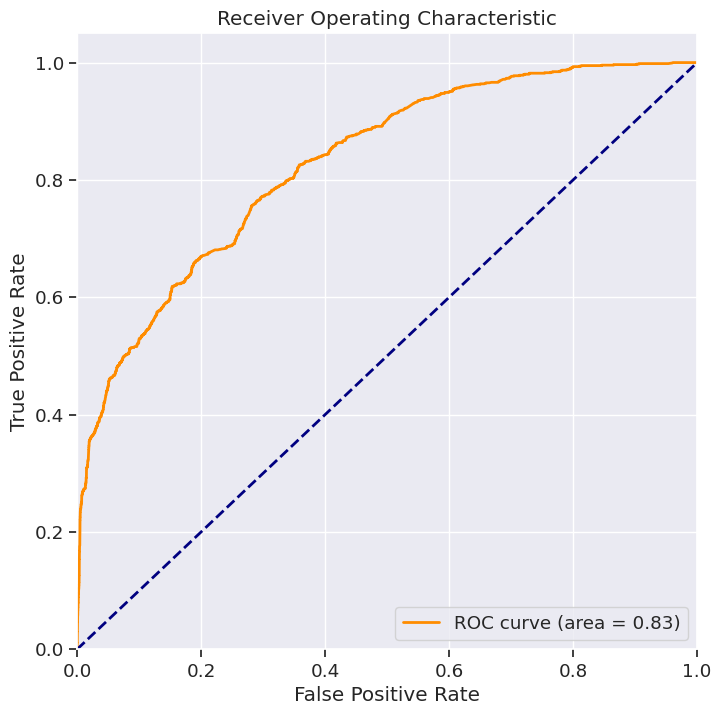

In [543]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
import xgboost as xgb
from sklearn.metrics import roc_auc_score, roc_curve, auc
import matplotlib.pyplot as plt

def evaluate_random_forest(X_train, X_test, y_train, y_test):
    model = RandomForestClassifier(n_estimators=200, random_state=39, max_depth=4)
    model.fit(X_train, y_train)

    print('Random Forest - Train set:')
    train_pred = model.predict(X_train)
    train_r2 = r2_score(y_train, train_pred)
    train_mae = mean_absolute_error(y_train, train_pred)
    train_mse = mean_squared_error(y_train, train_pred)
    train_rmse = (train_mse ** 0.5)
    train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train)[:, 1])
    print(f'R2: {train_r2:.2f}, MAE: {train_mae:.2f}, MSE: {train_mse:.2f}, RMSE: {train_rmse:.2f}, ROC-AUC: {train_roc_auc:.2f}')

    print('Random Forest - Test set:')
    test_pred = model.predict(X_test)
    test_r2 = r2_score(y_test, test_pred)
    test_mae = mean_absolute_error(y_test, test_pred)
    test_mse = mean_squared_error(y_test, test_pred)
    test_rmse = (test_mse ** 0.5)
    test_roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:, 1])
    print(f'R2: {test_r2:.2f}, MAE: {test_mae:.2f}, MSE: {test_mse:.2f}, RMSE: {test_rmse:.2f}, ROC-AUC: {test_roc_auc:.2f}')

    # Gráfico ROC
    fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test)[:, 1])
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()

evaluate_random_forest(X_train, X_test, y_train, y_test)

Gradient Boosting - Train set:
R2: 0.21, MAE: 951043448235047168.00, MSE: 0.06, RMSE: 0.24, ROC-AUC: 0.89
Gradient Boosting - Test set:
R2: 0.19, MAE: 927655763395612416.00, MSE: 0.06, RMSE: 0.24, ROC-AUC: 0.88


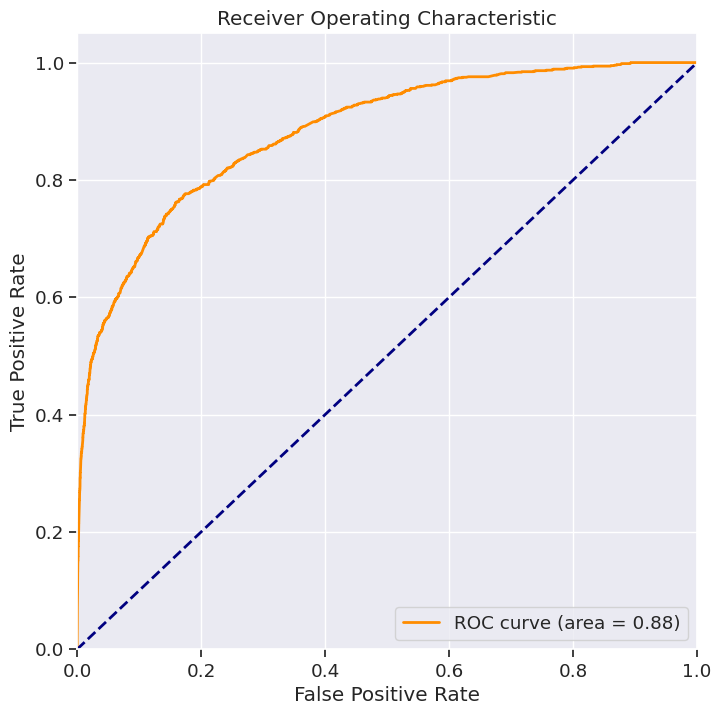

In [544]:
def evaluate_gradient_boosting(X_train, X_test, y_train, y_test):
    model = GradientBoostingClassifier(n_estimators=100, max_depth=3, random_state=39)
    model.fit(X_train, y_train)

    print('Gradient Boosting - Train set:')
    train_pred = model.predict(X_train)
    train_r2 = r2_score(y_train, train_pred)
    train_mae = mean_absolute_error(y_train, train_pred)
    train_mse = mean_squared_error(y_train, train_pred)
    train_rmse = (train_mse ** 0.5)
    train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train)[:, 1])
    print(f'R2: {train_r2:.2f}, MAE: {train_mae:.2f}, MSE: {train_mse:.2f}, RMSE: {train_rmse:.2f}, ROC-AUC: {train_roc_auc:.2f}')

    print('Gradient Boosting - Test set:')
    test_pred = model.predict(X_test)
    test_r2 = r2_score(y_test, test_pred)
    test_mae = mean_absolute_error(y_test, test_pred)
    test_mse = mean_squared_error(y_test, test_pred)
    test_rmse = (test_mse ** 0.5)
    test_roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:, 1])
    print(f'R2: {test_r2:.2f}, MAE: {test_mae:.2f}, MSE: {test_mse:.2f}, RMSE: {test_rmse:.2f}, ROC-AUC: {test_roc_auc:.2f}')

    # Gráfico ROC
    fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test)[:, 1])
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()

evaluate_gradient_boosting(X_train, X_test, y_train, y_test)

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Logistic Regression - Train set:
R2: 0.10, MAE: 1054947860639768064.00, MSE: 0.07, RMSE: 0.26, ROC-AUC: 0.85
Logistic Regression - Test set:
R2: 0.11, MAE: 996920727062484864.00, MSE: 0.06, RMSE: 0.25, ROC-AUC: 0.85


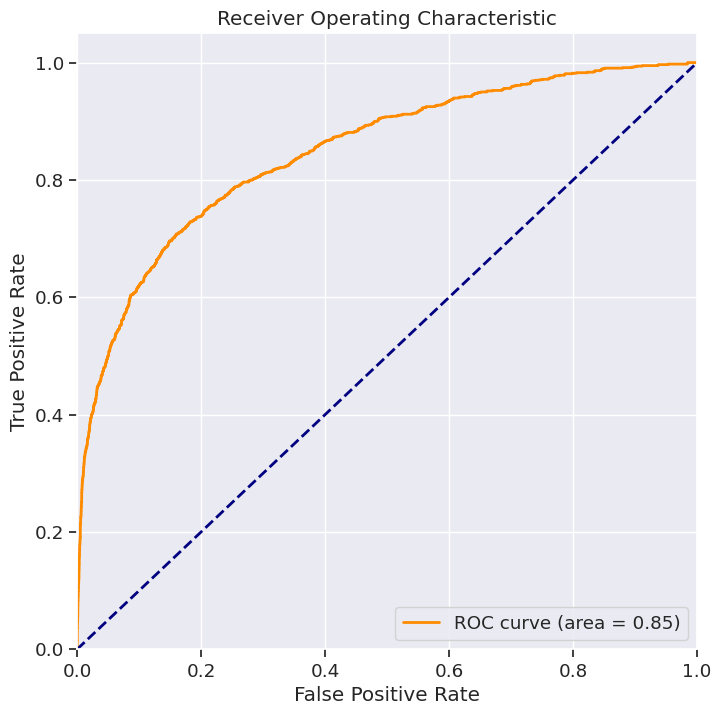

In [545]:
# Función para evaluar Logistic Regression
def evaluate_logistic_regression(X_train, X_test, y_train, y_test):
    model = LogisticRegression(random_state=39)
    model.fit(X_train, y_train)

    print('Logistic Regression - Train set:')
    train_pred = model.predict(X_train)
    train_r2 = r2_score(y_train, train_pred)
    train_mae = mean_absolute_error(y_train, train_pred)
    train_mse = mean_squared_error(y_train, train_pred)
    train_rmse = (train_mse ** 0.5)
    train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train)[:, 1])
    print(f'R2: {train_r2:.2f}, MAE: {train_mae:.2f}, MSE: {train_mse:.2f}, RMSE: {train_rmse:.2f}, ROC-AUC: {train_roc_auc:.2f}')

    print('Logistic Regression - Test set:')
    test_pred = model.predict(X_test)
    test_r2 = r2_score(y_test, test_pred)
    test_mae = mean_absolute_error(y_test, test_pred)
    test_mse = mean_squared_error(y_test, test_pred)
    test_rmse = (test_mse ** 0.5)
    test_roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:, 1])
    print(f'R2: {test_r2:.2f}, MAE: {test_mae:.2f}, MSE: {test_mse:.2f}, RMSE: {test_rmse:.2f}, ROC-AUC: {test_roc_auc:.2f}')

    # Gráfico ROC
    fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test)[:, 1])
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()

evaluate_logistic_regression(X_train, X_test, y_train, y_test)

XGBoost - Train set:
R2: 0.26, MAE: 0.06, MSE: 0.06, RMSE: 0.24, ROC-AUC: 0.90
XGBoost - Test set:
R2: 0.21, MAE: 0.06, MSE: 0.06, RMSE: 0.24, ROC-AUC: 0.89


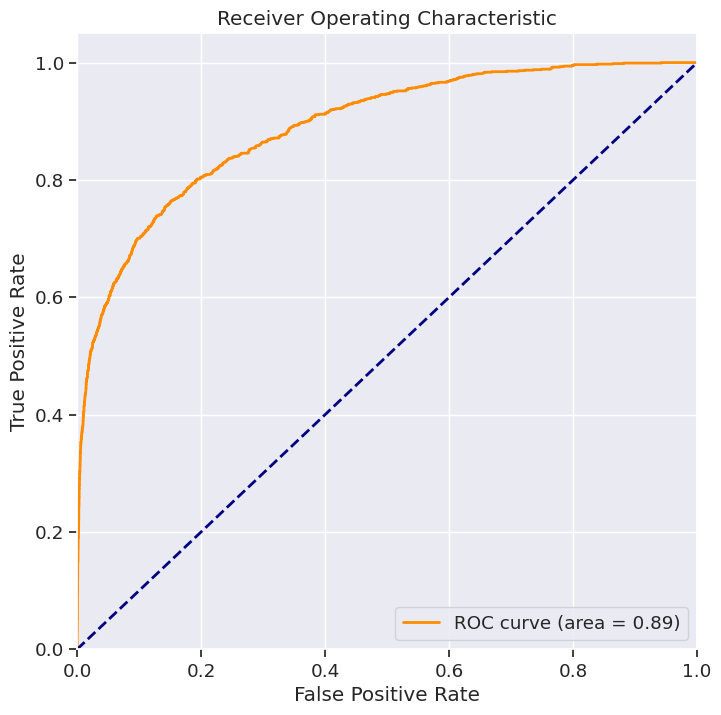

In [546]:
# Función para evaluar XGBoost
def evaluate_xgboost(X_train, X_test, y_train, y_test):
    model = xgb.XGBClassifier(n_estimators=100, max_depth=3, random_state=39)
    model.fit(X_train, y_train)

    print('XGBoost - Train set:')
    train_pred = model.predict(X_train)
    train_r2 = r2_score(y_train, train_pred)
    train_mae = mean_absolute_error(y_train, train_pred)
    train_mse = mean_squared_error(y_train, train_pred)
    train_rmse = (train_mse ** 0.5)
    train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train)[:, 1])
    print(f'R2: {train_r2:.2f}, MAE: {train_mae:.2f}, MSE: {train_mse:.2f}, RMSE: {train_rmse:.2f}, ROC-AUC: {train_roc_auc:.2f}')

    print('XGBoost - Test set:')
    test_pred = model.predict(X_test)
    test_r2 = r2_score(y_test, test_pred)
    test_mae = mean_absolute_error(y_test, test_pred)
    test_mse = mean_squared_error(y_test, test_pred)
    test_rmse = (test_mse ** 0.5)
    test_roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:, 1])
    print(f'R2: {test_r2:.2f}, MAE: {test_mae:.2f}, MSE: {test_mse:.2f}, RMSE: {test_rmse:.2f}, ROC-AUC: {test_roc_auc:.2f}')

    # Gráfico ROC
    fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test)[:, 1])
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()

evaluate_xgboost(X_train, X_test, y_train, y_test)

In [547]:
#Probemos ahora con el segundo dataset, hotels_2

In [548]:
# Separamos nuestro dataset hotels_1 en train y test
X_train, X_test, y_train, y_test = train_test_split(
    hotels_2.drop(labels=['Children'], axis=1),
    hotels_2['Children'],
    test_size=0.3,
    random_state=0)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((34797, 92), (14914, 92), (34797,), (14914,))

Random Forest - Train set:
R2: -0.09, MAE: 1519867093695585280.00, MSE: 0.08, RMSE: 0.29, ROC-AUC: 0.86
Random Forest - Test set:
R2: -0.08, MAE: 1433537373034019840.00, MSE: 0.08, RMSE: 0.28, ROC-AUC: 0.85


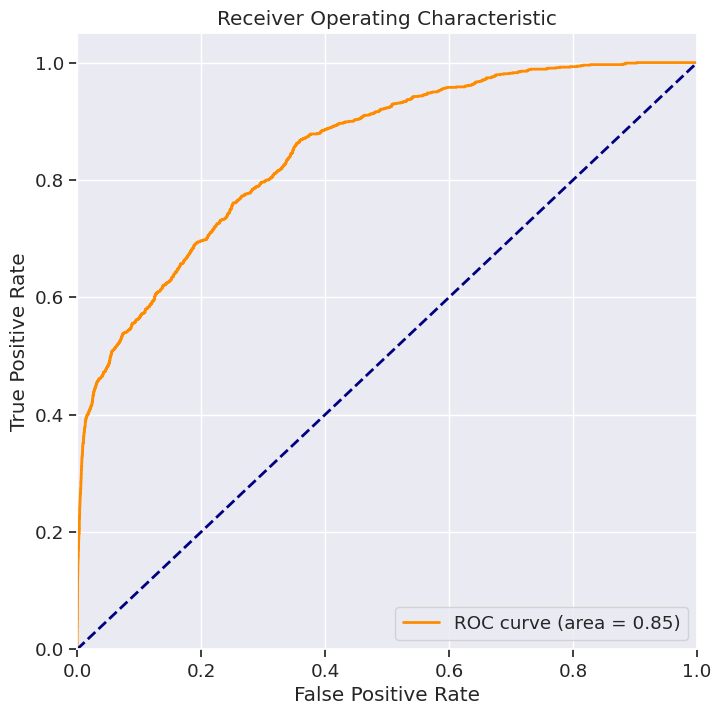

In [549]:
evaluate_random_forest(X_train, X_test, y_train, y_test)

Gradient Boosting - Train set:
R2: 0.25, MAE: 898561117479601408.00, MSE: 0.06, RMSE: 0.24, ROC-AUC: 0.91
Gradient Boosting - Test set:
R2: 0.23, MAE: 858390799728739968.00, MSE: 0.06, RMSE: 0.23, ROC-AUC: 0.90


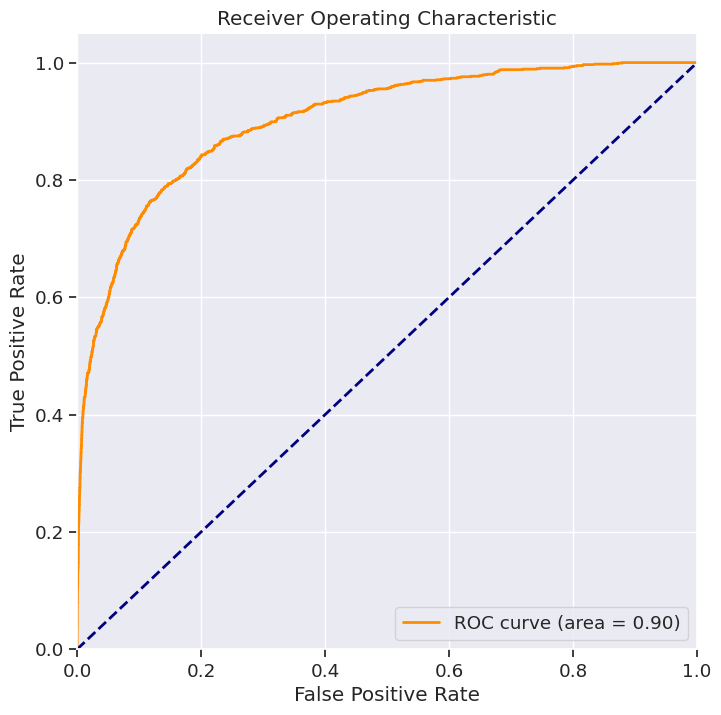

In [550]:
evaluate_gradient_boosting(X_train, X_test, y_train, y_test)

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Logistic Regression - Train set:
R2: 0.11, MAE: 1013068020946028544.00, MSE: 0.07, RMSE: 0.26, ROC-AUC: 0.86
Logistic Regression - Test set:
R2: 0.09, MAE: 989499480955319936.00, MSE: 0.07, RMSE: 0.26, ROC-AUC: 0.86


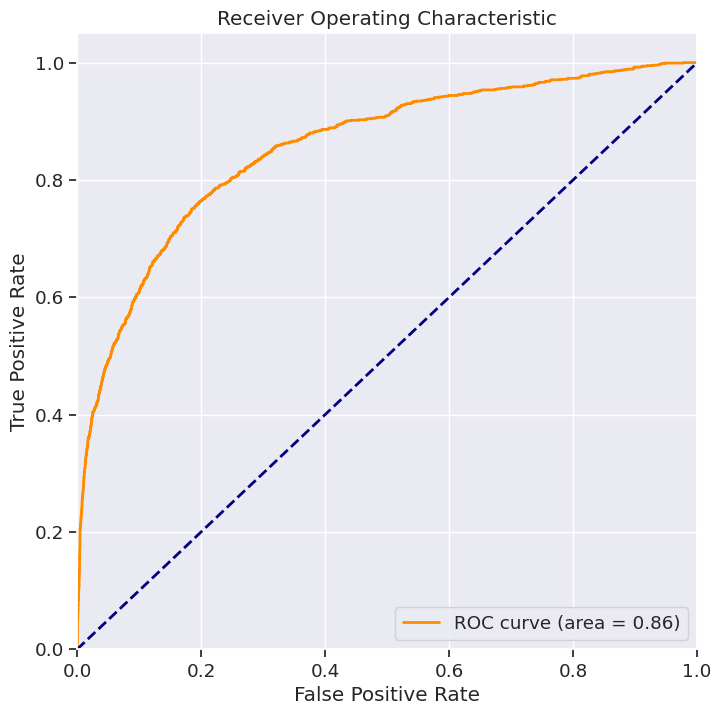

In [551]:
evaluate_logistic_regression(X_train, X_test, y_train, y_test)

XGBoost - Train set:
R2: 0.29, MAE: 0.05, MSE: 0.05, RMSE: 0.23, ROC-AUC: 0.93
XGBoost - Test set:
R2: 0.24, MAE: 0.05, MSE: 0.05, RMSE: 0.23, ROC-AUC: 0.91


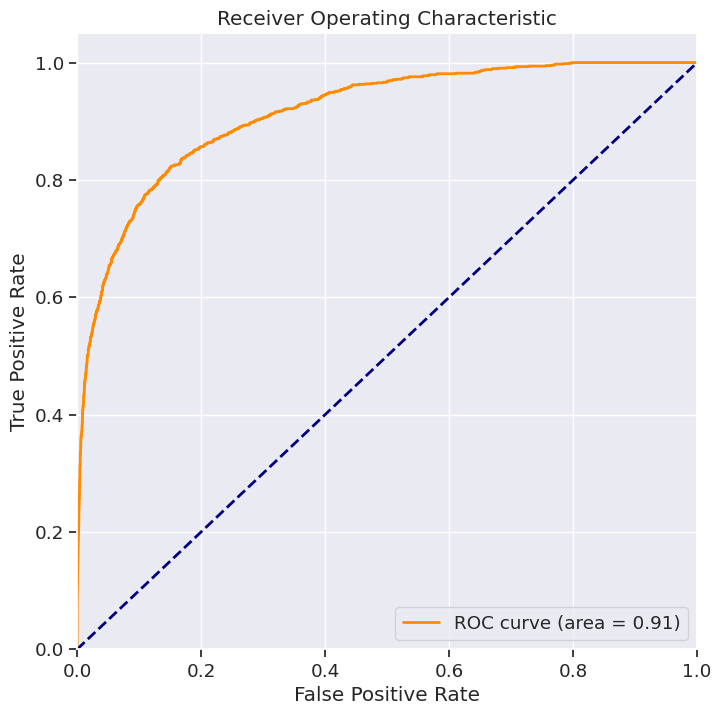

In [552]:
evaluate_xgboost(X_train, X_test, y_train, y_test)

In [553]:
#Probemos escalado los datos a ver si obtenemos mejores resultados

from sklearn.preprocessing import StandardScaler

# Crea un objeto StandardScaler
scaler = StandardScaler()

# Ajusta el escalador a los datos de entrenamiento y transforma los datos de entrenamiento
X_train_scaled = scaler.fit_transform(X_train)

# Transforma los datos de prueba utilizando el mismo escalador
X_test_scaled = scaler.transform(X_test)

Random Forest - Train set:
R2: -0.09, MAE: 1519867093695585280.00, MSE: 0.08, RMSE: 0.29, ROC-AUC: 0.86
Random Forest - Test set:
R2: -0.08, MAE: 1433537373034019840.00, MSE: 0.08, RMSE: 0.28, ROC-AUC: 0.85


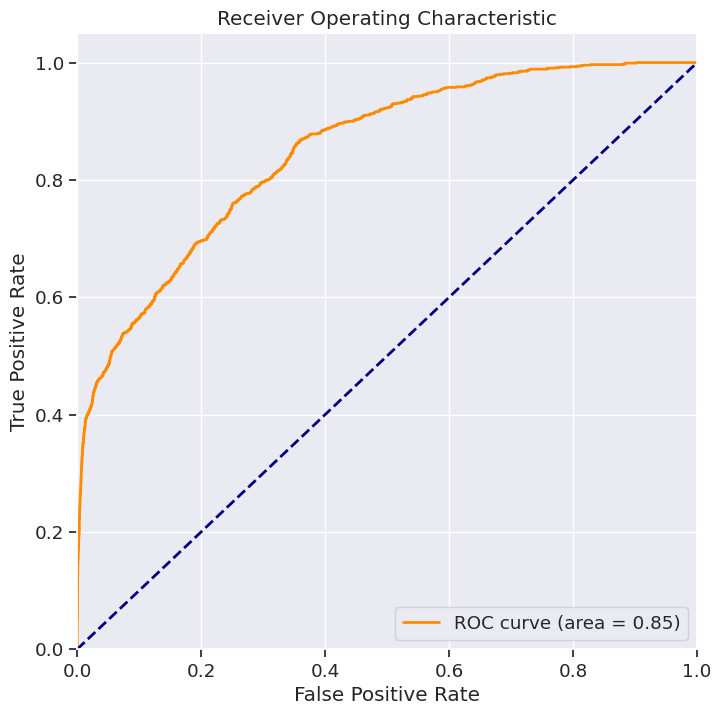

In [554]:
evaluate_random_forest(X_train_scaled, X_test_scaled, y_train, y_test)

Gradient Boosting - Train set:
R2: 0.25, MAE: 898561117479601408.00, MSE: 0.06, RMSE: 0.24, ROC-AUC: 0.91
Gradient Boosting - Test set:
R2: 0.23, MAE: 858390799728739968.00, MSE: 0.06, RMSE: 0.23, ROC-AUC: 0.90


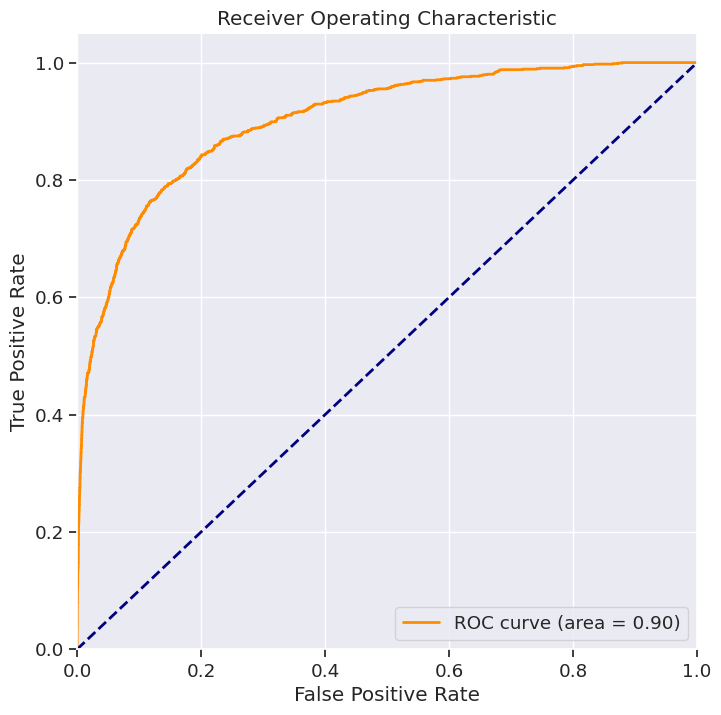

In [555]:
evaluate_gradient_boosting(X_train_scaled, X_test_scaled, y_train, y_test)

Logistic Regression - Train set:
R2: 0.16, MAE: 973838804017715456.00, MSE: 0.06, RMSE: 0.25, ROC-AUC: 0.87
Logistic Regression - Test set:
R2: 0.14, MAE: 917760768586059264.00, MSE: 0.06, RMSE: 0.25, ROC-AUC: 0.87


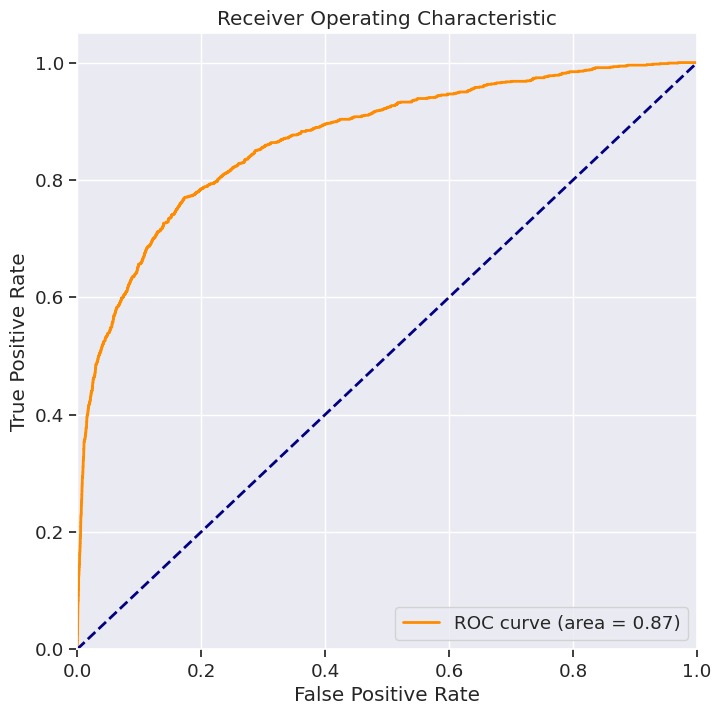

In [556]:
evaluate_logistic_regression(X_train_scaled, X_test_scaled, y_train, y_test)

XGBoost - Train set:
R2: 0.29, MAE: 0.05, MSE: 0.05, RMSE: 0.23, ROC-AUC: 0.93
XGBoost - Test set:
R2: 0.24, MAE: 0.05, MSE: 0.05, RMSE: 0.23, ROC-AUC: 0.91


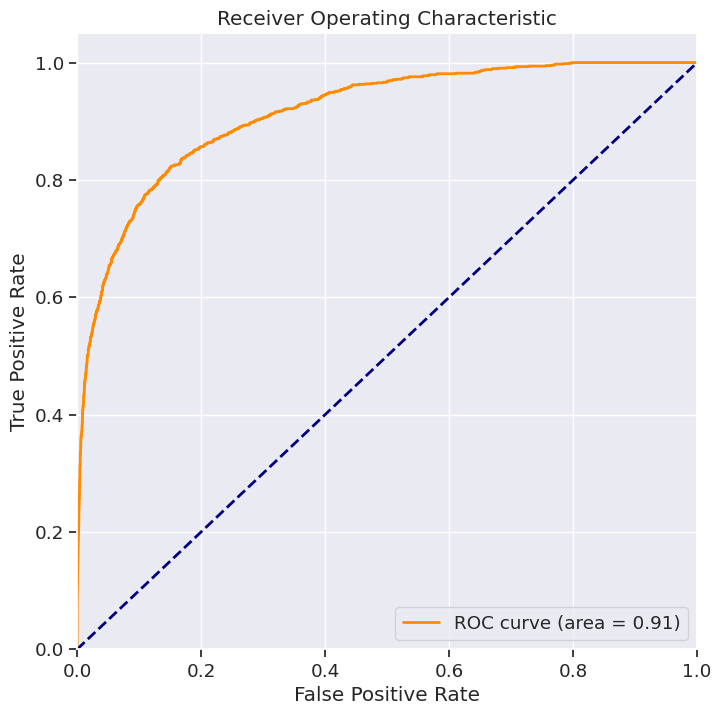

In [557]:
evaluate_xgboost(X_train_scaled, X_test_scaled, y_train, y_test)

# Utilizemos Shap para visualizar la importancia que cada variable tuvo en determinar la clasificación

In [559]:
! pip install shap

In [568]:
import shap

Características más importantes:
                                Feature  Importance
71                 reserved_room_type_G    0.138739
67                 reserved_room_type_C    0.061085
68                 reserved_room_type_D    0.059393
70                 reserved_room_type_F    0.057931
65                 reserved_room_type_A    0.056878
..                                  ...         ...
48                          country_ROU    0.000000
40                          country_KOR    0.000000
32                          country_GRC    0.000000
33                          country_HRV    0.000000
91  required_car_parking_spaces_parking    0.000000

[92 rows x 2 columns]


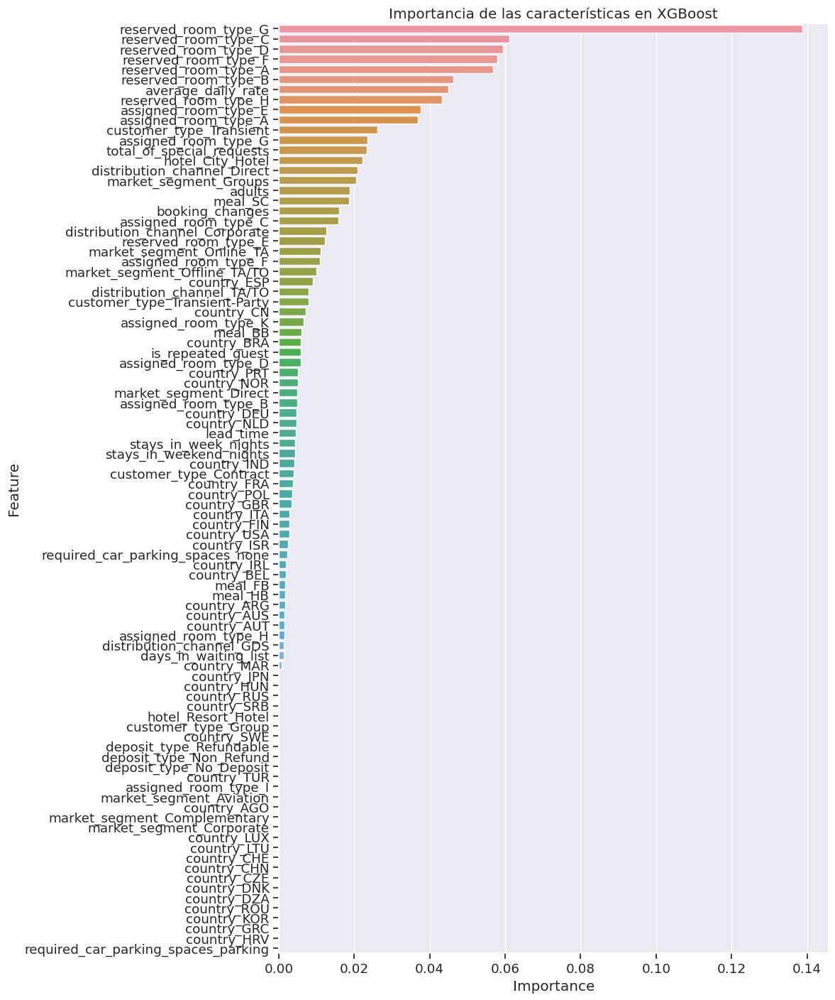

In [578]:
import xgboost as xgb

def evaluate_xgboost(X_train, X_test, y_train, y_test):
    model = xgb.XGBClassifier(n_estimators=100, max_depth=3, random_state=39)
    model.fit(X_train, y_train)

    # Obtenemos la importancia de las características
    feature_importance = model.feature_importances_

    # Creamos un DataFrame para visualizar las importancias de las características
    feature_importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importance})

    # Ordenamos las características por importancia en orden descendente
    feature_importance_df = feature_importance_df.sort_values (by='Importance', ascending=False)

    # Imprimimos o visualizamos las características más importantes
    print("Características más importantes:")
    print(feature_importance_df)

    # Realiza predicciones en el conjunto de prueba
    y_pred = model.predict(X_test)


    plt.figure(figsize=(10, 17))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_df)
    plt.title("Importancia de las características en XGBoost")
    plt.show()

    return model, y_pred

# Llama a la función para entrenar el modelo y obtener la importancia de las características
xgb_model, y_pred = evaluate_xgboost(X_train, X_test, y_train, y_test)

[22:41:39] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


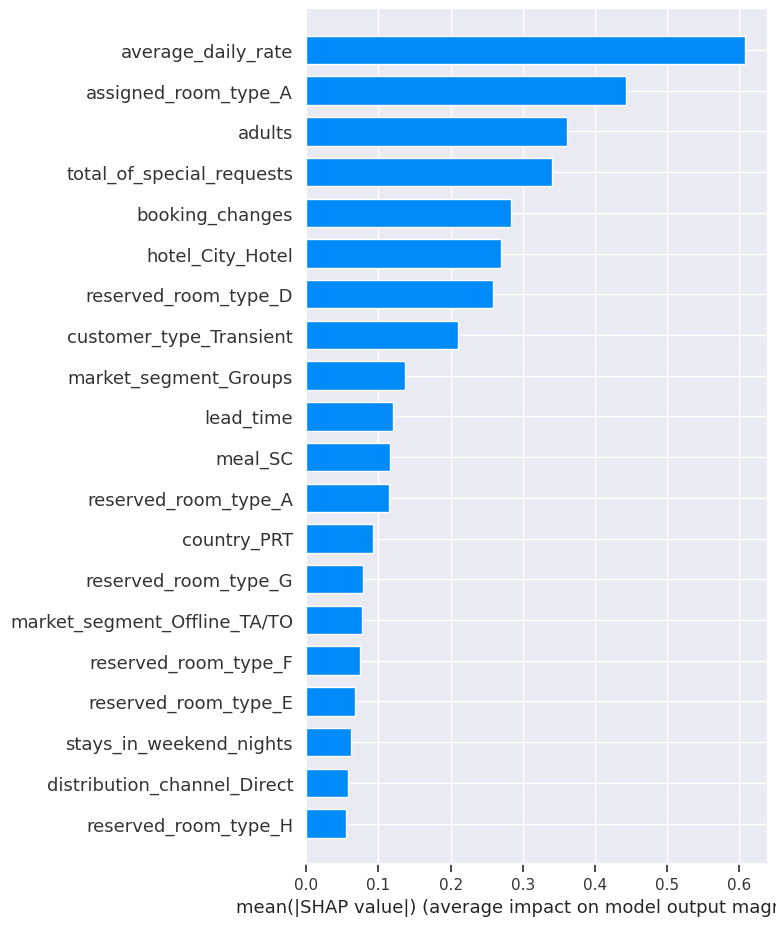

In [573]:
#Implementamos shap para determinar el aportre de cada variable

explainer = shap.TreeExplainer(xgb_model)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, plot_type="bar")

## Part III - Results & Conclusions

In [574]:
#Referirse a la PPT enviada